## Проект №2. Разведывательный анализ данных.


<span style="color:white">(attachment:image.png)</span>
    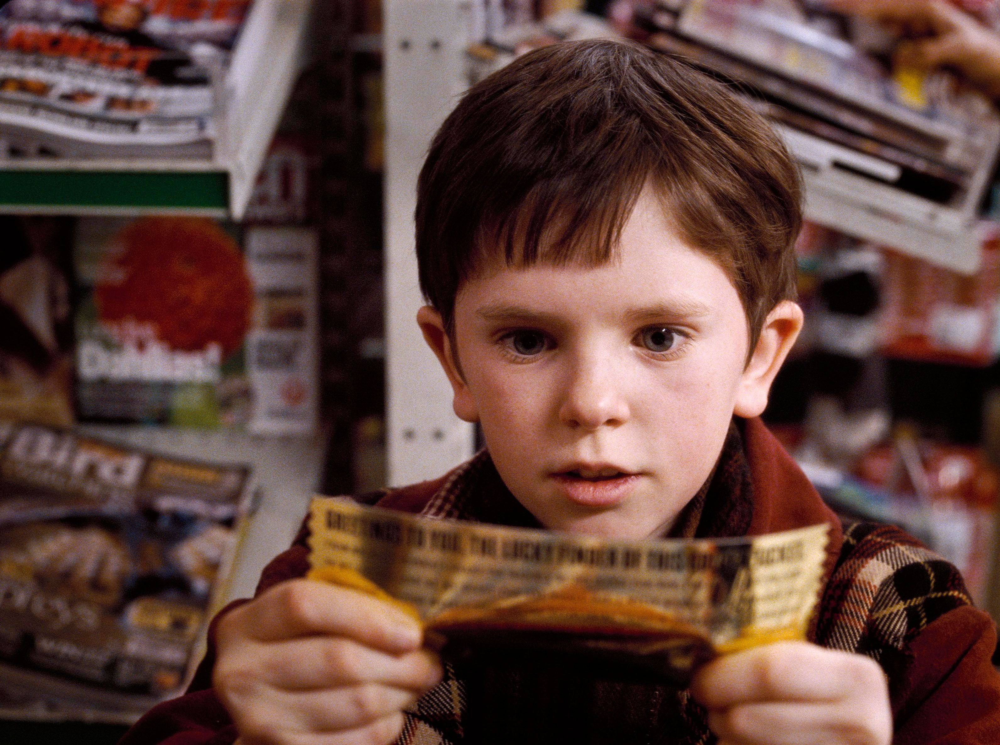

Вас пригласили поучаствовать в одном из проектов UNICEF — международного подразделения ООН, чья миссия состоит в повышении уровня благополучия детей по всему миру. 

Суть проекта — отследить влияние условий жизни учащихся в возрасте от 15 до 22 лет на их успеваемость по математике, чтобы на ранней стадии выявлять студентов, находящихся в группе риска.

И сделать это можно с помощью модели, которая предсказывала бы результаты госэкзамена по математике для каждого ученика школы (вот она, сила ML!). Чтобы определиться с параметрами будущей модели, проведите разведывательный анализ данных и составьте отчёт по его результатам. 

# Рекомендации по выполнению проекта
1. Проведите первичную обработку данных. Так как данных много, стоит написать функции, которые можно применять к столбцам определённого типа.
2. Посмотрите на распределение признака для числовых переменных, устраните выбросы.
3. Оцените количество уникальных значений для номинативных переменных.
4. По необходимости преобразуйте данные
5. Проведите корреляционный анализ количественных переменных
6. Отберите не коррелирующие переменные.
7. Проанализируйте номинативные переменные и устраните те, которые не влияют на предсказываемую величину (в нашем случае — на переменную score).
8. Не забудьте сформулировать выводы относительно качества данных и тех переменных, которые вы будете использовать в дальнейшем построении модели.

## Импортируем необходимые для работы библиотеки

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import random

from itertools import combinations
from scipy.stats import ttest_ind
# from scipy import stats
# from tabulate import tabulate # необходима установка библиотеки "pip install tabulate"

# импортируем библиотеки для определения типов хранимых данных в исходных данных
from pandas.api.types import is_string_dtype
from pandas.api.types import is_numeric_dtype
from pandas.api.types import is_float_dtype
from pandas.api.types import is_integer_dtype

# изменим настройки по умолчнию на свои
pd.set_option('display.max_rows', 100) # показывать больше строк
pd.set_option('display.max_columns', 50) # показывать больше колонок
pd.set_option('display.max_colwidth', 200) # показывать шире колонки, это для моей таблици-описания таблицы данных
%matplotlib inline

Ссылка на <a href="https://lms.skillfactory.ru/assets/courseware/v1/425d6864db937e4ebabc972e581769ab/asset-v1:Skillfactory+DST-9+11DEC2019+type@asset+block/stud_math.csv">исходные данные</a>
или в папке проекта находится копия исходных данных

In [2]:
# загрузим исходные данные
stud_math = pd.read_csv('stud_math.csv')

In [3]:
# загрузим файл с описанием столбцов (это и будет таблица-описание)
# файл я создал на основе текстового описания к заданию
stud_math_description = pd.read_csv('stud_math_description.csv')

# Приведем все названия столбцов к нижнему регистру (они у нас в столбце column)
stud_math_description['column']=stud_math_description['column'].str.lower()

In [4]:
# сделаем индексом столбец с названиями столбцов
stud_math_description=stud_math_description.set_index('column')

# добавим новые столбцы в таблицу описания
# добавляю здесь, чтобы потом было проще мне работать с ними

# тип поля
stud_math_description['type_field']=''

# количество заполненных строк
stud_math_description['fill_number']=''

# количество пустых строк
stud_math_description['not_fill_number']=''

# количество уникальных значений (не пустых) в столбце
stud_math_description['num_uniq_values']=''

# выводы по данным в столбце
stud_math_description['conlcusion']=''
stud_math_description['conlcusion2']=''

In [5]:
# сделаем функцию для добавления новых данных в таблицу-описания данных
# эта функция мне нужна в начале - объявляю её здесь (не со всеми другими)

def add_description(field,type_field,fill_number,not_fill_number,num_uniq_values,conlcusion):
    stud_math_description['type_field'].loc[field]=type_field
    stud_math_description['fill_number'].loc[field]=fill_number
    stud_math_description['not_fill_number'].loc[field]=not_fill_number
    stud_math_description['num_uniq_values'].loc[field]=num_uniq_values
    stud_math_description['conlcusion'].loc[field]=conlcusion

## Описание датасета

Посмотрим на переменные, которые содержит датасет:
1. <span style="color:blue">**school**</span> — аббревиатура школы, в которой учится ученик
2. <span style="color:blue">**sex**</span> — пол ученика ('F' - женский, 'M' - мужской)
3. <span style="color:blue">**age**</span> — возраст ученика (от 15 до 22)
4. <span style="color:blue">**address**</span> — тип адреса ученика ('U' - городской, 'R' - за городом)
5. <span style="color:blue">**famsize**</span> — размер семьи('LE3' <= 3, 'GT3' >3)
6. <span style="color:blue">**Pstatus**</span> — статус совместного жилья родителей ('T' - живут вместе 'A' - раздельно)
7. <span style="color:blue">**Medu**</span> — образование матери (0 - нет, 1 - 4 класса, 2 - 5-9 классы, 3 - среднее специальное или 11 классов, 4 - высшее)
8. <span style="color:blue">**Fedu**</span> — образование отца (0 - нет, 1 - 4 класса, 2 - 5-9 классы, 3 - среднее специальное или 11 классов, 4 - высшее)
9. <span style="color:blue">**Mjob**</span> — работа матери ('teacher' - учитель, 'health' - сфера здравоохранения, 'services' - гос служба, 'at_home' - не работает, 'other' - другое)
10. <span style="color:blue">**Fjob**</span> — работа отца ('teacher' - учитель, 'health' - сфера здравоохранения, 'services' - гос служба, 'at_home' - не работает, 'other' - другое)
11. <span style="color:blue">**reason**</span> — причина выбора школы ('home' - близость к дому, 'reputation' - репутация школы, 'course' - образовательная программа, 'other' - другое)
12. <span style="color:blue">**guardian**</span> — опекун ('mother' - мать, 'father' - отец, 'other' - другое)
13. <span style="color:blue">**traveltime**</span> — время в пути до школы (1 - <15 мин., 2 - 15-30 мин., 3 - 30-60 мин., 4 - >60 мин.)
14. <span style="color:blue">**studytime**</span> — время на учёбу помимо школы в неделю (1 - <2 часов, 2 - 2-5 часов, 3 - 5-10 часов, 4 - >10 часов)
15. <span style="color:blue">**failures**</span> — количество внеучебных неудач (n, если 1<=n<=3, иначе 0)
16. <span style="color:blue">**schoolsup**</span> — дополнительная образовательная поддержка (yes или no)
17. <span style="color:blue">**famsup**</span> — семейная образовательная поддержка (yes или no)
18. <span style="color:blue">**paid**</span> — дополнительные платные занятия по математике (yes или no)
19. <span style="color:blue">**activities**</span> — дополнительные внеучебные занятия (yes или no)
20. <span style="color:blue">**nursery**</span> — посещал детский сад (yes или no)
21. <span style="color:blue">**higher**</span> — хочет получить высшее образование (yes или no)
22. <span style="color:blue">**internet**</span> — наличие интернета дома (yes или no)
23. <span style="color:blue">**romantic**</span> — в романтических отношениях (yes или no)
24. <span style="color:blue">**famrel**</span> — семейные отношения (от 1 - очень плохо до 5 - очень хорошо)
25. <span style="color:blue">**freetime**</span> — свободное время после школы (от 1 - очень мало до 5 - очень мого)
26. <span style="color:blue">**goout**</span> — проведение времени с друзьями (от 1 - очень мало до 5 - очень много)
27. <span style="color:blue">**health**</span> — текущее состояние здоровья (от 1 - очень плохо до 5 - очень хорошо)
28. <span style="color:blue">**absences**</span> — количество пропущенных занятий
29. <span style="color:blue">**score**</span> — баллы по госэкзамену по математике

## Произведем первичную легкую корректировку данных и сбор информации

<span style="color:green">**делаю это первым шагом, вместо объявления собственных функций, так как функции используют данные из таблицы-описания**</span>

In [6]:
# Для удобства использования pandas переименуем столбец "studytime, granular":
stud_math.rename(columns={'studytime, granular':'studytime_granular' }, inplace = True)

# Приведем все названия столбцов к нижнему регистру
stud_math.columns = map(str.lower,stud_math.columns)

# посмотрим на результат
display(stud_math.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 395 entries, 0 to 394
Data columns (total 30 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   school              395 non-null    object 
 1   sex                 395 non-null    object 
 2   age                 395 non-null    int64  
 3   address             378 non-null    object 
 4   famsize             368 non-null    object 
 5   pstatus             350 non-null    object 
 6   medu                392 non-null    float64
 7   fedu                371 non-null    float64
 8   mjob                376 non-null    object 
 9   fjob                359 non-null    object 
 10  reason              378 non-null    object 
 11  guardian            364 non-null    object 
 12  traveltime          367 non-null    float64
 13  studytime           388 non-null    float64
 14  failures            373 non-null    float64
 15  schoolsup           386 non-null    object 
 16  famsup  

None

In [7]:
# Посмотрим признаки на пропуски данных

# создадим список для заполнения данными
data=[]

# пройдемся циклом по всем столбцам и запишем результат в наш список
for col in stud_math.columns:
    pct_missing = round(stud_math[col].isna().mean()*100,2)
    nmb_missing = stud_math[col].isna().sum()
    if pct_missing>0:
        data.append([col,pct_missing,nmb_missing])

# посмотрим на результат (col_name,pct_missing,nmb_missing - 
# название столбца, процент и число пропусков соответственно)
results_missing=pd.DataFrame(data,columns=['col_name','pct_missing',
                    'nmb_missing']).sort_values(by='pct_missing',ascending=False)

print('\nВыведем ТОП-15 признаков по пропущенным данным')
display(results_missing.head(15))
print('\nСтолбцов с пропусками данных:',len(results_missing))  
print('Всего не заполнено ячеек:',results_missing.nmb_missing.sum(),' из ', stud_math.size,
      ' (',round(results_missing.nmb_missing.sum()/stud_math.size*100,2),'%)\n' )


Выведем ТОП-15 признаков по пропущенным данным


,col_name,pct_missing,nmb_missing
2,pstatus,11.39,45
14,paid,10.13,40
13,famsup,9.87,39
6,fjob,9.11,36
19,internet,8.61,34
20,romantic,7.85,31
8,guardian,7.85,31
9,traveltime,7.09,28
21,famrel,6.84,27
1,famsize,6.84,27



Столбцов с пропусками данных: 27
Всего не заполнено ячеек: 565  из  11850  ( 4.77 %)



<font color=color_text>
Итого получилось, у нас в наборе данных:  
    
* 30 столбцов: 13 численных (12 дробных и 1 целочисленный) и 17 текстовых.  
* 395 строчек.  

Столбцов с пропусками 27, причем только два из них содержат действительно много пропусков - **pstatus** и **paid** (с процентом пропусков более 10%).
</font>

In [8]:
# и теперь посмотрим на сами данные
#  поскольку столбцов очень много - выведем на экран транспонированную таблицу
# и для интереса выведем не первые 10, а случайно выбранные 
# поскольку признаков много - выведем их транспонированно

display(stud_math.sample(10).transpose())

,76,199,211,196,337,45,187,78,176,16
school,GP,GP,GP,GP,GP,GP,GP,GP,GP,GP
sex,M,F,M,M,F,F,M,M,F,F
age,15,16,17,17,17,15,16,17,16,16
address,U,U,U,U,U,U,U,U,U,U
famsize,NaN,LE3,LE3,GT3,GT3,LE3,LE3,NaN,GT3,GT3
pstatus,T,T,T,T,T,A,T,T,T,T
medu,4,4,4,4,3,4,2,2,2,4
fedu,0,4,4,4,2,3,1,1,2,4
mjob,teacher,teacher,services,services,NaN,other,other,other,services,services
fjob,other,teacher,other,teacher,other,other,other,other,other,services


Теперь займемся заполнением нашей таблицы-описания данных

In [9]:
#  соберем списки полей по их типам (это надо для функции по сбору предварительных выводов)
# возьмем все названия столбцов
list_columns=list(stud_math.columns)

# создадим предварительно пустые списки под каждый тип данных
list_columns_str=[]
list_columns_int=[]
list_columns_float=[]

# пробежимся по всем наименованиям и внесем в соответствующий список
for column_name in list_columns:
    if is_string_dtype(stud_math[column_name])==True:
        list_columns_str.append(column_name)
    if is_integer_dtype(stud_math[column_name])==True:
        list_columns_int.append(column_name)
    if is_float_dtype(stud_math[column_name])==True:
        list_columns_float.append(column_name)

# и отсортируем полученные списки
list_columns_str=sorted(list_columns_str)
list_columns_int=sorted(list_columns_int)
list_columns_float=sorted(list_columns_float)

# # это ели мы захотим проверить, что списки правильно заполнены
# print(list_columns_str,', число элементов списка -',len(list_columns_str))
# print(list_columns_int,'число элементов списка -',len(list_columns_int))
# print(list_columns_float,'число элементов списка -',len(list_columns_float))

In [12]:
# теперь собственно заполняем таблицу stud_math_description
# для перебора всех списков сделаем список)))
list_lists=[list_columns_str, list_columns_int,list_columns_float]

for ly in list_lists: 
    
    # создадим переменную для понимания типа поля листа (нам это потом пригодится для анализа данных)
    if ly==list_columns_str:
        type_field='text'
    elif ly==list_columns_int:
        type_field='int'
    elif ly==list_columns_float:
        type_field='float'    
    else:
        # это на случай какой-либо ошибки, чтобы легче найти было
        type_field='unreserved'    
    
    # теперь будем перибирать сами столбцы в каждом списке
    for column_name in ly:
        
        if type_field=='text':
            # первым делом заменим отсутствующие значения на пустые
            stud_math[column_name] = stud_math[column_name].astype(str).apply(lambda x: None if x.strip() == '' else x)

        #display(pd.DataFrame(stud_math[column_name].value_counts()))

        # посчитаем заполенные и нет строчки и запишем в таблицу описание
        if stud_math[column_name].dtype == 'int64' or stud_math[column_name].dtype == "float64":
            not_filled=stud_math[stud_math[column_name].isnull()==True][column_name].size
            filled=len(stud_math[column_name])-not_filled
        else: 
            filled=len(stud_math[stud_math[column_name]!='nan'])
            not_filled=len(stud_math[stud_math[column_name]=='nan'])

        # посмотрим сколько уникальных значений в столце (кроме значения "nan")
        num_uniq_values=stud_math[stud_math[column_name]!='nan'][column_name].nunique()
        
        conlcusion=''
        add_description(column_name,type_field,filled,not_filled,num_uniq_values,conlcusion)

# посмотрим какие данные мы собрали в таблице-описания
stud_math_description

,description,type_field,fill_number,not_fill_number,num_uniq_values,conlcusion,conlcusion2
column,,,,,,,
school,"аббревиатура школы, в которой учится ученик",text,395,0,2,,
sex,"пол ученика ('F' - женский, 'M' - мужской)",text,395,0,2,,
age,возраст ученика (от 15 до 22),int,395,0,8,,
address,"тип адреса ученика ('U' - городской, 'R' - за городом)",text,378,17,2,,
famsize,"размер семьи('LE3' <= 3, 'GT3' >3)",text,368,27,2,,
pstatus,статус совместного жилья родителей ('T' - живут вместе 'A' - раздельно),text,350,45,2,,
medu,"образование матери (0 - нет, 1 - 4 класса, 2 - 5-9 классы, 3 - среднее специальное или 11 классов, 4 - высшее)",float,392,3,5,,
fedu,"образование отца (0 - нет, 1 - 4 класса, 2 - 5-9 классы, 3 - среднее специальное или 11 классов, 4 - высшее)",float,371,24,6,,
mjob,"работа матери ('teacher' - учитель, 'health' - сфера здравоохранения, 'services' - гос служба, 'at_home' - не работает, 'other' - другое)",text,376,19,5,,


<span style="color:red">Получилось у нас 27 столбцов с пропусками данных (из 30). Получается, что у нас очень много отсутствующих данных.</span> 

In [10]:
# дополним наши данные столбцами с информацией был ли заполнен столбец с пропусками изначально или нет.  
# после изменения таблицы и при моделировании это может оказаться важной информацией
list_col_missing=list(results_missing.col_name)

# скопируем исходные данные и дальше будем работать с копией
stud_math_pdata=stud_math.copy()

# пройдемся циклом по столбцам с пропусками
for col in list_col_missing:
    if col in stud_math_pdata:
#         stud_math_pdata[col + '_was_missing'] = stud_math_pdata[col].isnull()
        stud_math_pdata[col + '_was_missing'] = stud_math_pdata[col].apply(
                    lambda x: True if x=='nan' or pd.isna(x)==True else False)


In [11]:
# посмотрим на результат
display(stud_math_pdata.sample(10).transpose())

,362,169,1,184,330,281,382,392,79,224
school,MS,GP,GP,GP,GP,GP,MS,MS,GP,GP
sex,F,F,F,F,M,M,M,M,F,F
age,18,16,17,16,18,17,17,21,16,16
address,U,U,U,U,U,U,U,R,U,U
famsize,GT3,GT3,GT3,GT3,LE3,LE3,GT3,GT3,NaN,GT3
pstatus,T,T,NaN,T,T,A,T,T,T,T
medu,3,4,1,3,2,3,2,1,3,4
fedu,3,4,1,2,2,NaN,3,1,4,4
mjob,services,health,at_home,other,other,teacher,other,other,at_home,NaN
fjob,services,NaN,other,other,other,services,services,other,other,services


## 1. Здесь напишем свои функции.  

только теперь можно писать функции

In [12]:
# функция получения типа поля данных из моей таблицы-описания
def type_field(field_name):
    dh=pd.DataFrame(stud_math_description.loc[field_name])
    return dh.loc[dh.index[1]][field_name]

In [13]:
# функция проверки пропущенных данных в столбце.
# я использую её для дополнительной проверки по окончании работы с признаком
#  чтобы убедиться, что я всё сделал правильно

# я сравниваю по заполненным дополнительным мною созданным признакам
#  до того как я начал изменять набор данных

def check_res_of_filling(field_name):
    miss_field_name=field_name+'_was_missing' # собираем имя нового столбца признака пропуска данных
    print('Было пропущенных значений:',stud_math_pdata[stud_math_pdata[miss_field_name]==True][miss_field_name].sum())
    
    k=type_field(field_name)
    # в зависимости от типа поля приходится считать пропуски по разному
    if k=='float' or k=='int':
        print('Осталось пропущенных значений:',stud_math_pdata[field_name].isna().sum())
    else:
        print('Осталось пропущенных значений:',stud_math_pdata[stud_math_pdata[field_name]=='nan'][miss_field_name].sum())

In [14]:
# функция определения значений выбросов и других статистических показателей

def blowouts(field):
    IQR = stud_math_pdata[field].quantile(0.75) - stud_math_pdata[field].quantile(0.25)
    perc25 = stud_math_pdata[field].quantile(0.25)
    perc50 = stud_math_pdata[field].quantile(0.50)
    perc75 = stud_math_pdata[field].quantile(0.75)
    low_border=perc25 - 1.5*IQR
    high_border=perc75 + 1.5*IQR
    
    # посчитаем количество выбросов ниже нижней границы
    num_down_blowouts=len(stud_math_pdata[stud_math_pdata[field]<=low_border])
    
    # выведем соответствующее сообщение (от результатов подсчета нижних выбросов)
    if num_down_blowouts>0:
        mes_d='Нижние выбросы есть, их: ' + str(num_down_blowouts) + '.'
    else:
        mes_d='Нижних выбросов нет.'
    
    # посчитаем количество выбросов выше верхней границы
    num_up_blowouts=len(stud_math_pdata[stud_math_pdata[field]>=high_border])
    
    # выведем соответствующее сообщение (от результатов подсчета верхних выбросов)
    if num_up_blowouts>0:
        mes_u='Верхние выбросы есть, их: ' + str(num_up_blowouts) + '.'
    else:
        mes_u='Верхних выбросов нет.'
    
    print('----------------------------------------------------------------------------------------------------------------')
    count=stud_math_pdata[field].describe().transpose()[0]
    mean=stud_math_pdata[field].describe().transpose()[1]
    std=stud_math_pdata[field].describe().transpose()[2]
    minim=stud_math_pdata[field].describe().transpose()[3]
    maxim=stud_math_pdata[field].describe().transpose()[7]

    print(
    '25-й перцентиль: {},'.format(perc25),
    '75-й перцентиль: {},'.format(perc75),
    "IQR: {}, ".format(IQR),
    "Границы выбросов: [{f}, {l}].".format(f=perc25 - 1.5*IQR, l=perc75 + 1.5*IQR))
    
    print('----------------------------------------------------------------------------------------------------------------')
    print(mes_d,mes_u)
    print('----------------------------------------------------------------------------------------------------------------')
    

    data=[count,mean,std,IQR,perc25,perc50,perc75,
          low_border,high_border,num_down_blowouts,num_up_blowouts,minim,maxim]
    res=pd.DataFrame(data,index=['count','mean','std','IQR','perc25','perc50','perc75',
                                 'low_border','high_border','num_down_blowouts',
                                 'num_up_blowouts','minim','maxim']
                     ,columns=[field])
    
    # вернем результат вычислений функии
    return res

In [15]:
# функция составления датафрэйма уникальных значений и их долями в столбце
def table_prc(field_name):
    df_wrk=pd.DataFrame(stud_math_pdata[field_name].value_counts())
    df_wrk['%']=pd.DataFrame(round(stud_math_pdata.groupby(field_name).size() / len(stud_math_pdata[field_name])*100,1))
    display(df_wrk)

In [16]:
def get_boxplot(column):
    df=stud_math_pdata.copy() # сделаем копию данных
    
    fig, ax = plt.subplots(figsize = (10, 5)) # зададим размеры графика
    sns.boxplot(x=column, y='score', 
                data=df.loc[df.loc[:, column].isin(df.loc[:, column].value_counts().index[:10])],ax=ax)
    plt.xticks(rotation=45) # поворот наименований по оси х
    ax.set_title('Boxplot для признака ' + column) # укажем наименование графика
    plt.show()  # выведем график

In [17]:
# напишем функцию для сбора информации и предварительного вывода по данным в столбце
# это функция для получения первичной информации по признаку.
# она запускается первым делом при рассмотрении признака, уже потом 
# производятся манипуляции с данными в признаке

def check_field(field_name):
    # посмотрим на распределение данных
    df_wrk=pd.DataFrame(stud_math_pdata[field_name].value_counts())
    df_wrk['%']=pd.DataFrame(round(stud_math_pdata.groupby(field_name).size() / len(stud_math_pdata[field_name])*100,1))
    print('value_counts')
    display(df_wrk.T)

    if field_name in stud_math_description.index: 
        # эта проверка нужна для отсечки одного столбца неприсутствующего в описании к данным
        # так как я его не стал добавлять в исходный файл таблицы-описания
        
        num_uniq_values=stud_math_description['num_uniq_values'].loc[field_name]
        not_fill_number=stud_math_description['not_fill_number'].loc[field_name]

        # conсl - переменная для склейки вывода 
        conсl='В столбце '+str(field_name)+ \
              ' встречается '+str(num_uniq_values)+ \
              ' уникальных значений. Число незаполненных строчек - '+str(not_fill_number)+ '. '

        # сделаем проверку на наличие пустых строк
        if 'nan' in df_wrk.index:
            # есть пропущенные строчки в данных
            percent_not_fill=df_wrk['%'].loc['nan']
        else:
            # всё заполнено
            percent_not_fill=0

        # Попробуем получить первоначальный вывод по нашим данным
        text='' # переменная для склейки вывода 
        if percent_not_fill>0.01 and num_uniq_values>=2:
            pass
        elif not_fill_number==0:
            text='Все строки заполнены!'
        else:
            text='Надо бы заполнить отсутствующие значения'

        # теперь склеиваем предварительный вывод и сохраняем его
        conсlusion=conсl+text  
        stud_math_description['conlcusion'].loc[field_name]=conсlusion

        # выводим на экран результат
        display(pd.DataFrame(stud_math_description.loc[field_name]))
        
        # построим графики распределения значений для цифровых полей
        type_field=stud_math_description['type_field'].loc[field_name] 
        plt.figure(figsize=(10, 5)) # задаем размеры графика
        
        if (type_field=='int' or type_field=='float'):
            # выводим статистичекие показатели признака
            display(blowouts(field_name).T)
            
            # выводим количество значений в признаке
            display(sns.countplot(x=field_name, data=stud_math_pdata))
            
            # если признак не оценка, то строим боксплот
            if field_name!='score':
                get_boxplot(field_name)
        else:
            # строим график соотношения уникальных значений друг относительно друга
#             plt.figure(figsize=(10, 5))
            sns.countplot(x=field_name, data=stud_math_pdata)

In [18]:
# функция по фиксации номера строчки которую мы изменяем.
# создаем новый столбец с значениями True/False 
# True = я в строчке изменил значение

def write_changed_col(cols,list_ch):
    if cols in stud_math_pdata.columns:
        new_column_name=str(cols) + '_was_changed' # название нового признака
        if new_column_name not in stud_math_pdata.columns:
            stud_math_pdata[new_column_name] = "False"
        stud_math_pdata.loc[list_ch,new_column_name] = "True"

In [19]:
# функция получения списков цифровык и категориальных признаков
def get_list_cols_by_types(df):
    object_cols = list(df.select_dtypes(exclude=[np.number,'bool']).columns)
    numeric_cols = list(df.select_dtypes(include=np.number).columns)
    return object_cols, numeric_cols

## 2. Первичный осмотр данных

<AxesSubplot:>

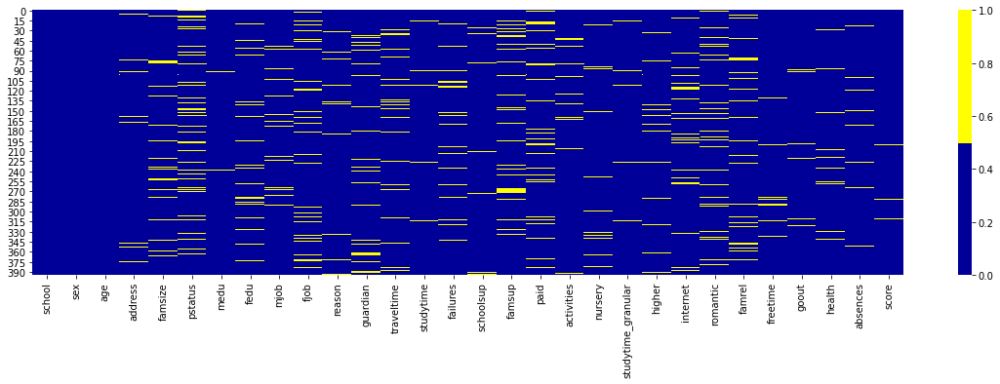

In [20]:
# построим тепловую карту пропусков

cols = stud_math.columns # только по исходным данным
# определяем цвета 
# желтый - пропущенные данные, синий - не пропущенные
colours = ['#000099', '#ffff00'] 
plt.figure(figsize=(20, 5)) # зададим размер графика - у нас много столбцов
sns.heatmap(stud_math[cols].isnull(), cmap=sns.color_palette(colours))

<AxesSubplot:xlabel='index'>

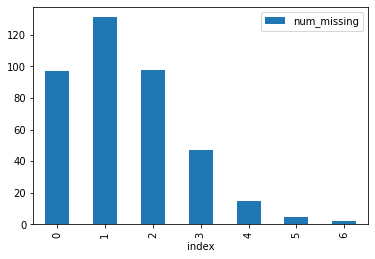

In [21]:
# на основе индикатора для признаков с пропущенными данными строим гистограмму
ismissing_cols = [col for col in stud_math_pdata.columns if '_was_missing' in col]
stud_math_pdata['num_missing'] = stud_math_pdata[ismissing_cols].sum(axis=1)

# и теперь сам график
stud_math_pdata['num_missing'].value_counts().reset_index().sort_values(by='index').plot.bar(x='index', y='num_missing')

In [22]:
stud_math_pdata['num_missing'] .value_counts()

1    131
2     98
0     97
3     47
4     15
5      5
6      2
Name: num_missing, dtype: int64

<span style="color:blue">97 строк не содержат пропусков, а около 130 строк содержат только 1 пропуск в данных. Именно на эти строки мы и будем опираться при построеннии модели. Остальные пропуски мы либо заполним, либо удалим из финального набора данных (сохранив иформацию о том, что строка была модифицирована для моделирования).</span>

## 3. Подробное рассмотрение данных

## <font color='green'>**3.1 school** </font> 

value_counts


,GP,MS
school,349.0,46.0
%,88.4,11.6


,school
description,"аббревиатура школы, в которой учится ученик"
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце school встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


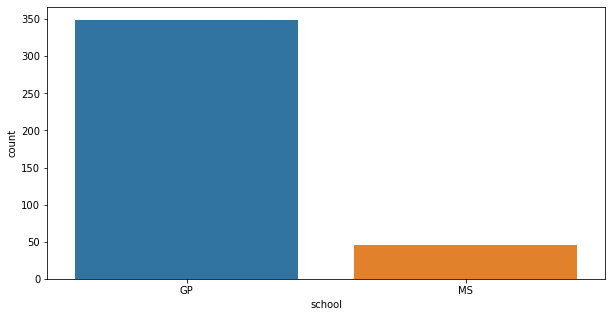

In [23]:
field_name='school'
check_field(field_name)

<span style="color:blue">Категориальный признак.  
Пустых строчек нет - данные по этому столбцу полные и без выбросов.  
Всего два значения и более 88% принадлежит одному из них.</span> 

In [24]:
# добавим вывод по столбцу в таблицу с описанием stud_math_description
conlcusion2='Категориальный признак. Пустых строчек нет - \
данные по этому столбцу полные и без выбросов. \
Всего два значения и более 88% принадлежит одному из них.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.2 sex** </font>

value_counts


,F,M
sex,208.0,187.0
%,52.7,47.3


,sex
description,"пол ученика ('F' - женский, 'M' - мужской)"
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце sex встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


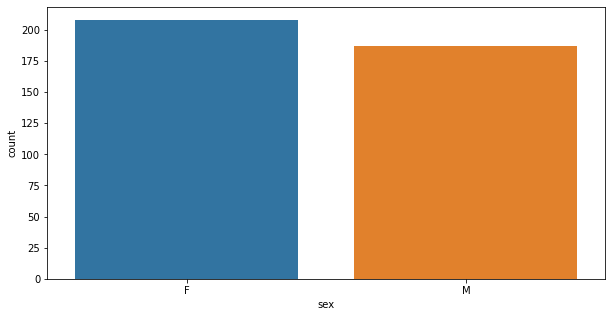

In [25]:
field_name='sex'
check_field(field_name)

<span style="color:red">Категориальный признак не содержащий пропусков и имеющий только два уникальных значения, распределенных практичеки поровну. Данные по этому столбцу полные и без выбросов.</span> 

In [26]:
# добавим вывод по столбцу в таблицу с описанием stud_math_description
conlcusion2='Категориальный признак не содержащий пропусков и имеющий только два уникальных значения, \
распределенных практичеки поровну. Данные по этому столбцу полные и без выбросов.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.3 age** </font>

value_counts


,16,17,18,15,19,20,22,21
age,104.0,98.0,82.0,82.0,24.0,3.0,1.0,1.0
%,26.3,24.8,20.8,20.8,6.1,0.8,0.3,0.3


,age
description,возраст ученика (от 15 до 22)
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце age встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


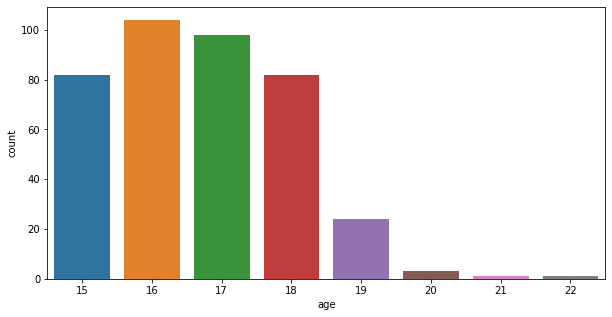

In [27]:
field_name='age'
check_field(field_name)

<span style="color:blue">по полученным данным видим, что у нас в основном учащиеся младшего возраста, практически все до 20 лет. Это хорошо - цель нашего исследования определить на ранней стадии проблемы с обучением. Также видим, что математика определила нам два выброса, хотя исходя из описания данных  видно, что выбросов нет - это корректные данные, поэтому мы их оставляем.</span>

In [28]:
# добавим вывод по столбцу в таблицу с описанием stud_math_description
conlcusion2='по полученным данным видим, что у нас в основном учащиеся \
младшего возраста, практически все до 20 лет. Это хорошо - цель нашего \
исследования определить на ранней стадии проблемы с обучением. \
Также видим, что математика определила нам два выброса, хотя исходя из \
описания данных видно, что выбросов нет - это корректные данные, \
поэтому мы их оставляем.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

Посмотрим на соотношение пола и возраста

<AxesSubplot:xlabel='age', ylabel='count'>

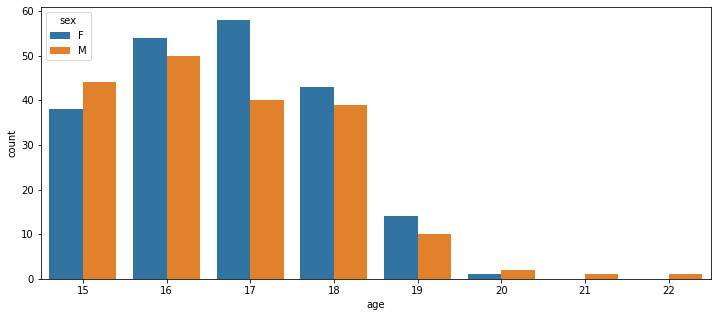

In [29]:
plt.figure(figsize=(12, 5))
sns.countplot(x='age', data=stud_math_pdata, hue='sex')

<span style="color:blue">Из графика видно только, что мальчики преобладают только в самом младшем и трех старших возрастах. Интересно с чем это связано? Получается что в среднем возрасте преобладают девушки - может быть их специально так отбирали по конкурсу. Не понятно. Либо же все мальчики ушли в военную школу/академию. Или рядом открылась похожая школа и они все туда ушли.  
Одно понятно, что с этим пока ничего сделать не можем.</span>

## <font color='green'>**3.4 address** </font>

value_counts


,U,R
address,295.0,83.0
%,74.7,21.0


,address
description,"тип адреса ученика ('U' - городской, 'R' - за городом)"
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце address встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


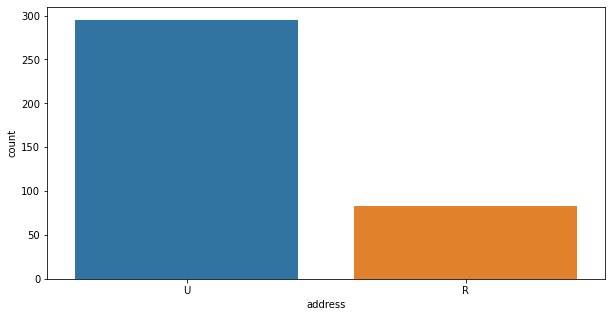

In [30]:
field_name='address'
check_field(field_name)

Признак содержит 17 пропусков, поработаем с ними.  
Взглянем на наше описание, что у нас может быть связано с данными по адресу и видим столбец  
"traveltime — время в пути до школы (1 - <15 мин., 2 - 15-30 мин., 3 - 30-60 мин., 4 - >60 мин.)"  

отберем данные по столбцам school,address,traveltime и address_was_missing

In [31]:
df=stud_math_pdata[['school', 'address', 'traveltime','address_was_missing']][stud_math_pdata['address_was_missing']==False]
# display(df.sample(10))
display(pd.DataFrame(df.value_counts()))

0
school address traveltime address_was_missing     
GP     U       1.0        False                192
               2.0        False                 56
       R       1.0        False                 29
               2.0        False                 18
MS     U       2.0        False                  9
GP     U       3.0        False                  9
MS     U       1.0        False                  8
       R       2.0        False                  8
               3.0        False                  7
               1.0        False                  5
GP     R       3.0        False                  5
       U       4.0        False                  3
       R       4.0        False                  3
MS     R       4.0        False                  1

Посмотрим на статистические данные

In [32]:
display(pd.DataFrame(df.groupby(['address', 'school']).traveltime.mean()))

traveltime
address school            
R       GP        1.672727
        MS        2.190476
U       GP        1.319231
        MS        1.529412

Мы можем заменить пропуски следующим образом -   
* если значение traveltime<1.3 на U  
* если traveltime больше 1.3 на R
* если значения traveltime нет - то поставим U, тк оно наиболее встречающееся.  

1.3 - потому что это среднее для GP школы (а у нас большинство ходит именно в эту школу) в городе, а для пригородных это время больше.

U    306
R     89
Name: address, dtype: int64

<AxesSubplot:xlabel='address', ylabel='count'>

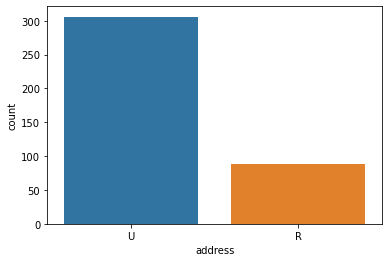

In [33]:
# это если бы меняли просто на одно значение
# stud.address = stud.address.apply(lambda x: 'U' if x=='nan' else x)

# наш рабочий вариант замены пропусков
stud_math_pdata['address'] = stud_math_pdata.apply(lambda x: ('R' if x.traveltime > 1.3 else 'U') 
                                                   if x.address=='nan' or pd.isna(x.address)==True else x.address, axis=1)

# теперь посмотрим на новое распределение и график
display(stud_math_pdata.address.value_counts())
sns.countplot(x='address', data=stud_math_pdata)

In [34]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 17
Осталось пропущенных значений: 0


<AxesSubplot:xlabel='address', ylabel='count'>

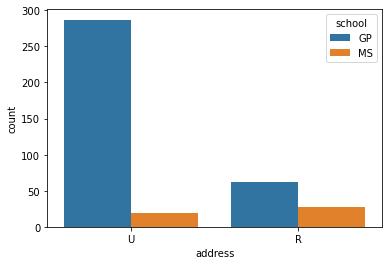

In [35]:
# посмотрим на распределение учеников по школам относительно места проживания
sns.countplot(x='address', data=stud_math_pdata, hue='school')

<span style="color:blue">Выбросов нет, но были пропуски - они заполнены релевантными данными. Из последнего графика видно, что ученики стараются идти в школу **GP** вне зависимости от места проживания. С чем это может быть связано нам не известно, но как правило родители стремятся отдать детей в самую лучшую по их возможностям школу.</span>

In [36]:
# добавим вывод по столбцу в таблицу с описанием stud_math_description
conlcusion2='Выбросов нет, но были пропуски - они заполнены релевантными данными. \
Из последнего графика видно, что ученики стараются идти в школу GP вне зависимости \
от места проживания. С чем это может быть связано нам не известно, но как правило \
родители стремятся отдать детей в самую лучшую по их возможностям школу.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.5 famsize** </font>

value_counts


,GT3,LE3
famsize,261.0,107.0
%,66.1,27.1


,famsize
description,"размер семьи('LE3' <= 3, 'GT3' >3)"
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце famsize встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


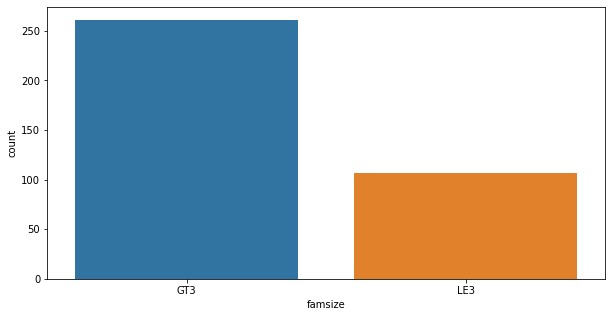

In [37]:
field_name='famsize'
check_field(field_name)

Заполнить пробелы нам может помочь столбец Pstatus (живут ли родители вместе) и школа в которой учится ученик. Посмотрим на такой срез.

In [38]:
df=pd.DataFrame(stud_math_pdata.groupby(['pstatus','school',field_name]).num_missing.count())
display(df)

num_missing
pstatus school famsize             
A       GP     GT3               20
               LE3               12
        MS     LE3                1
T       GP     GT3              186
               LE3               67
        MS     GT3               27
               LE3               14

Похоже что школа не влияет (покрайней мере не сильно) на размер семьи. Зато статус родителей - влияет. Поэтому заполним пропуски следующим образом - если родители живут раздельно, то ставим размер семьи LE3, а если вместе - GT3. В случае отсутствия признака pstatus ставим GT3, тк все учащиеся в школе GP, а там у большинства размер семьи больше 3.

count     395
unique      2
top       GT3
freq      285
Name: famsize, dtype: object

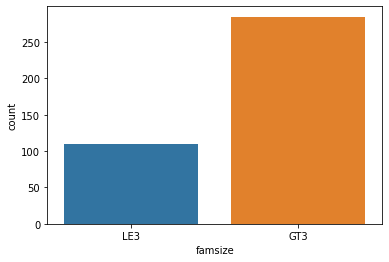

In [39]:
# заполним пусты значения
stud_math_pdata['famsize'] = stud_math_pdata.apply(lambda x: ('LE3' if x.pstatus == 'A' else 'GT3')\
                             if pd.isna(x[field_name]) or x.famsize=='nan' else x.famsize , axis=1)
# посмотрим на распределение
sns.countplot(x='famsize', data=stud_math_pdata)
display(stud_math_pdata.famsize.describe())

<AxesSubplot:xlabel='school', ylabel='count'>

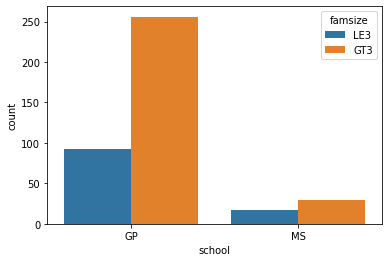

In [40]:
# Посмотрим на распределение учеников в разрезе школы и размера семьи
sns.countplot(x='school', data=stud_math_pdata, hue='famsize')

Из графика видно, что доля больших семей больше в школе GP.  
Может мы увидем зависимость между fsize и address? посмотрим

<AxesSubplot:xlabel='address', ylabel='count'>

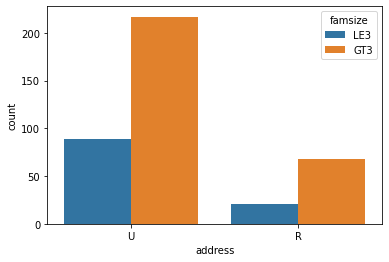

In [41]:
sns.countplot(x='address', data=stud_math_pdata, hue='famsize')

Интересно, что график практически полностью повторяет предыдущий. Исключение только одно, что больших семей больше стало за городом, при этом уменьшилось число больших семей в городе.

In [42]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 27
Осталось пропущенных значений: 0


<span style="color:red">Около 72% учеников живут в большой семье (трое и более членов семьи). Пропуски заполнили.</span>

In [43]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='Около 72% учеников живут в большой семье (трое и более \
членов семьи). Пропуски заполнили.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.6 pstatus** </font>

value_counts


,T,A
pstatus,314.0,36.0
%,79.5,9.1


,pstatus
description,статус совместного жилья родителей ('T' - живут вместе 'A' - раздельно)
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце pstatus встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


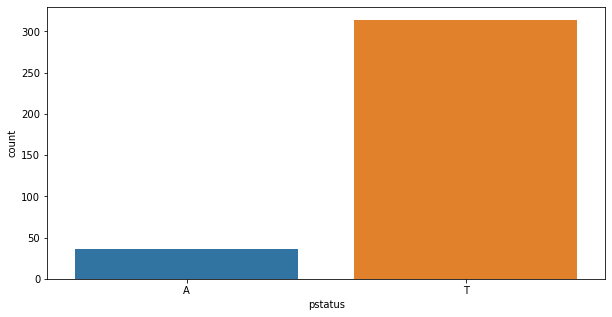

In [44]:
field_name='pstatus'
check_field(field_name)

Признак содержит 45 пропусков. У нас есть поле famsize - произведем замену значений с опорой на него.

In [45]:
df=pd.DataFrame(stud_math_pdata.groupby(['famsize',field_name]).num_missing.count())
display(df)

num_missing
famsize pstatus             
GT3     A                 20
        T                233
LE3     A                 16
        T                 81

Заполним замену по слудующему принципу: если семья больше 3, то ставим признак "T", если меньше - "А"

count     395
unique      2
top         T
freq      346
Name: pstatus, dtype: object

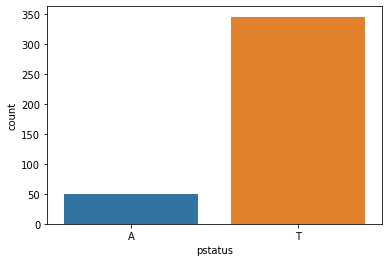

In [46]:
stud_math_pdata['pstatus'] = stud_math_pdata.apply(lambda x: ('T' if x.famsize == 'GT3' else 'A')\
                             if pd.isna(x[field_name]) or x.pstatus=='nan' else x.pstatus , axis=1)

# посмотрим на распределение
sns.countplot(x='pstatus', data=stud_math_pdata)
stud_math_pdata.pstatus.describe()

In [47]:
# посмотрим на распределение в числах
table_prc(field_name)

,pstatus,%
T,346,87.6
A,49,12.4


In [48]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 45
Осталось пропущенных значений: 0


<span style="color:red">Признак категориальный. 45 пропущенныех значений заполнено. 12.4% учеников живут в неполной семье.</span>

In [49]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='Признак категориальный. 45 пропущенныех значений заполнено. \
12.4% учеников живут в неполной семье.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.7 medu** </font>

value_counts


,4.0,2.0,3.0,1.0,0.0
medu,131.0,102.0,97.0,59.0,3.0
%,33.2,25.8,24.6,14.9,0.8


,medu
description,"образование матери (0 - нет, 1 - 4 класса, 2 - 5-9 классы, 3 - среднее специальное или 11 классов, 4 - высшее)"
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце medu встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


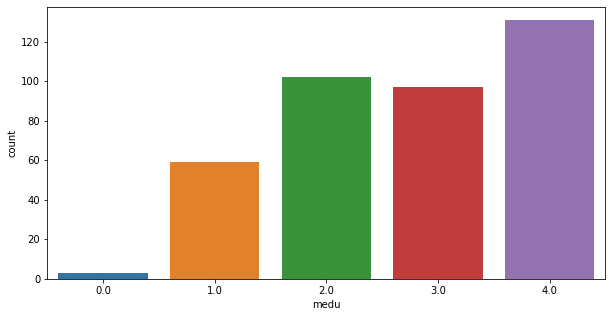

In [50]:
field_name='medu'
check_field(field_name)

<span style="color:red">По полученным данным видим, что выбросов нет. Более половины мам имеют среднее специальное или высшее образование</span>

In [51]:
# Заполним отсутствующие значения медианным значением
stud_math_pdata[field_name] = stud_math_pdata[field_name].fillna(stud_math_pdata[field_name].median())

In [52]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 3
Осталось пропущенных значений: 0


In [53]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='По полученным данным видим, что выбросов нет. \
Более половины мам имеют среднее специальное или высшее образование'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.8 fedu** </font>

value_counts


,2.0,3.0,4.0,1.0,0.0,40.0
fedu,106.0,96.0,88.0,78.0,2.0,1.0
%,26.8,24.3,22.3,19.7,0.5,0.3


,fedu
description,"образование отца (0 - нет, 1 - 4 класса, 2 - 5-9 классы, 3 - среднее специальное или 11 классов, 4 - высшее)"
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце fedu встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


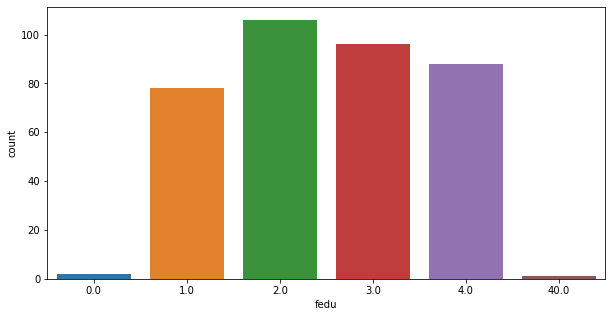

In [54]:
field_name='fedu'
check_field(field_name)

<span style="color:blue">по полученным данным видим, что выброс есть только один (хотя математика насчитала нам 3 выброса, еще два с нулевыми значениями) - мы можем его удалить либо посчитать это за опечатку и поставить 4 либо поставить какое либо другое значение. Попробуем посмотреть подробнее </span>

строчек с выбросами:  1


,original,modyfied_del,modyfied_to_4,modyfied_to_mean,modyfied_to_median,modyfied_to_mode,modyfied_my_version
mean,2.614555,2.505051,2.517520,2.513786,2.512129,2.512129,2.517520
median,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000
mode,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000
std,2.228732,1.053408,1.088808,1.086082,1.086397,1.086397,1.088808
var,4.967247,1.109668,1.185503,1.179575,1.180258,1.180258,1.185503


-----------------


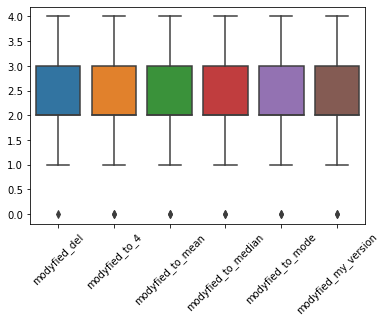

In [55]:
# получим индексы строчек со значением в нашем столбце больше 5
list_blowouts=stud_math_pdata[field_name].loc[stud_math_pdata[field_name] >5]
print('строчек с выбросами: ',len(list_blowouts))
# print(stud_math_absences, len(stud_math_absences))

# запишем индексы строчек с выбросами
list_of_lines=list_blowouts.index

df=stud_math_pdata.copy()
# stud_math_absences=stud_math_pdata[stud_math_pdata.loc[stud_math_pdata[field_name]] >8]
df1=df[df.absences>=8]
# stud_math_famrel=stud_math_famrel[stud_math_famrel.famrel>=0]

# просто заменим на 4
df2=df.copy()
for i in list_of_lines:
    df2.loc[i,[field_name]]=4

# рассмотрим другие варианты замены

# замена на средне арифметическое
df3=df.copy()
for i in list_of_lines:
    df3.loc[i,[field_name]]=df[field_name].mean()

# замена на медианное
df4=df.copy()
for i in list_of_lines:
    df4.loc[i,[field_name]]=df[field_name].median()

# замена на моду
df5=df.copy()
for i in list_of_lines:
    df5.loc[i,[field_name]]=df[field_name].mode()[0]

# еще один вариант
df6=df.copy()
for i in list_of_lines:
# заменяем значения на округленное до целого резальтат деления на 10
    val=round(df.loc[i,field_name]/10,0)
    df6.loc[i,field_name]=val
    
# соберем все результаты в единую таблицу - для удобства сравнения вариантов
results=pd.DataFrame({
    'original':[df[field_name].mean(),df[field_name].median(),
                df[field_name].mode()[0], df[field_name].std(),
                df[field_name].var()],
    'modyfied_del':[df1[field_name].mean(),df1[field_name].median(),
                    df1[field_name].mode()[0], df1[field_name].std(),
                    df1[field_name].var()],
    'modyfied_to_4':[df2[field_name].mean(),df2[field_name].median(),
                     df2[field_name].mode()[0], df2[field_name].std(),
                     df2[field_name].var()],
    'modyfied_to_mean':[df3[field_name].mean(),df3[field_name].median(),
                        df3[field_name].mode()[0],df3[field_name].std(),
                        df3[field_name].var()],
    'modyfied_to_median':[df4[field_name].mean(),df4[field_name].median(),
                          df4[field_name].mode()[0],df4[field_name].std(),
                          df4[field_name].var()],
    'modyfied_to_mode':[df5[field_name].mean(),df5[field_name].median(),
                        df5[field_name].mode()[0],df5[field_name].std(),
                        df5[field_name].var()],
    'modyfied_my_version':[df6[field_name].mean(),df6[field_name].median(),
                        df6[field_name].mode()[0],df6[field_name].std(),
                        df6[field_name].var()],    
    
    
},index = ['mean','median','mode','std','var'])
display(results)

results_fig=pd.DataFrame({
# просто ничего не видно, поэтому уберем из графика первоначальные данные
#     'original':df[field_name], 
    'modyfied_del':df1[field_name],
    'modyfied_to_4':df2[field_name],
    'modyfied_to_mean':df3[field_name],
    'modyfied_to_median':df4[field_name],
    'modyfied_to_mode':df5[field_name],
    'modyfied_my_version':df6[field_name],    
        
})


ax=sns.boxplot(data=results_fig)
plt.setp(ax.get_xticklabels(), rotation=45)
print('-----------------')


<span style="color:blue">сравнив полученные результаты, получается, что всё одинаково - поэтому просто исправляем "опечатку".</span>

In [56]:
# Это для варианта удаления строки с выбросом
# stud_math_pdata[field_name] = stud_math_pdata[field_name].loc[stud_math_pdata[field_name] <= 4]

In [57]:
# заменим опечатку на 4
# цикл на случай если у нас несколько строк с одинаковым значением для исправления
for i in list_of_lines:
    stud_math_pdata.loc[i,[field_name]]=4

count    371.000000
mean       2.517520
std        1.088808
min        0.000000
25%        2.000000
50%        2.000000
75%        3.000000
max        4.000000
Name: fedu, dtype: float64


<AxesSubplot:xlabel='fedu', ylabel='count'>

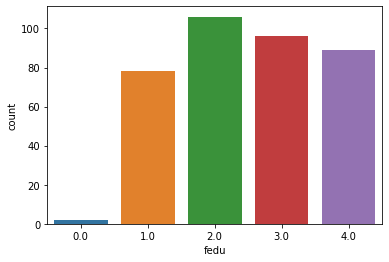

In [58]:
# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

Теперь исправим пропуски в данных

In [59]:
# Аналогично предыдущему полю заполним отсутствующие значения медианным значением
stud_math_pdata[field_name] = stud_math_pdata[field_name].fillna(stud_math_pdata[field_name].median())

In [60]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 24
Осталось пропущенных значений: 0


<span style="color:blue">Найденный выброс исправлен.  
    Для более простого анализа по семье введем новый признак - среднее образование матери и отца, которое будет показывать средний уровень образования обоих родителей.</span>

In [61]:
stud_math_pdata['medu_fedu_mean'] = round((stud_math_pdata['fedu'] + stud_math_pdata['medu']) / 2,0)
stud_math_pdata[['medu','fedu','medu_fedu_mean']].head()

,medu,fedu,medu_fedu_mean
0,4.0,4.0,4.0
1,1.0,1.0,1.0
2,1.0,1.0,1.0
3,4.0,2.0,3.0
4,3.0,3.0,3.0


In [62]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='Найденный выброс исправлен, отсутствующие \
значения заполнены. Для более \
простого анализа по семье введем новый признак - \
среднее образование матери и отца, которое будет \
показывать средний уровень образования обоих родителей.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.9 mjob** </font>

value_counts


,other,services,at_home,teacher,health
mjob,133.0,98.0,58.0,55.0,32.0
%,33.7,24.8,14.7,13.9,8.1


,mjob
description,"работа матери ('teacher' - учитель, 'health' - сфера здравоохранения, 'services' - гос служба, 'at_home' - не работает, 'other' - другое)"
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце mjob встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


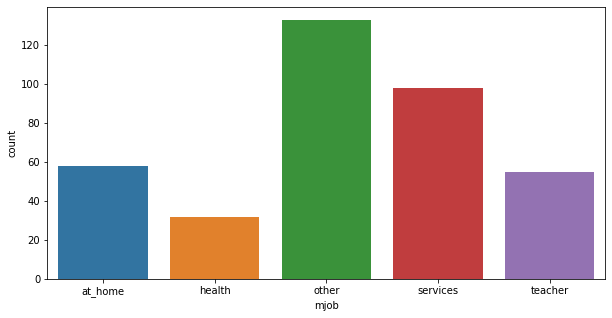

In [63]:
field_name='mjob'
check_field(field_name)

<span style="color:blue">19 незаполненных строчек. Интересно, что большинство ответов у варианта other</span>

In [64]:
# определить как лучше заполнить сложно, поэтому заполним самым часто встречающимся значением -"other"
stud_math_pdata[field_name] = stud_math_pdata[field_name].apply(lambda x: ('other' if pd.isna(x) or x=='nan' else x))

In [65]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 19
Осталось пропущенных значений: 0


count       395
unique        5
top       other
freq        152
Name: mjob, dtype: object


<AxesSubplot:xlabel='mjob', ylabel='count'>

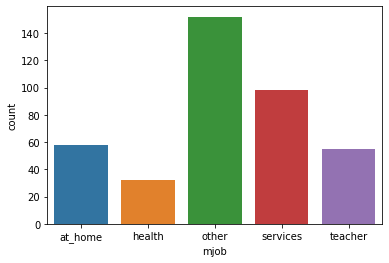

In [66]:
# посмотрим на результат заполнения пропусков
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

In [67]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='Обнаружено 19 незаполненных строчек. Заполнили их значением "other"'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.10 fjob** </font>

value_counts


,other,services,teacher,at_home,health
fjob,197.0,102.0,29.0,16.0,15.0
%,49.9,25.8,7.3,4.1,3.8


,fjob
description,"работа отца ('teacher' - учитель, 'health' - сфера здравоохранения, 'services' - гос служба, 'at_home' - не работает, 'other' - другое)"
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце fjob встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


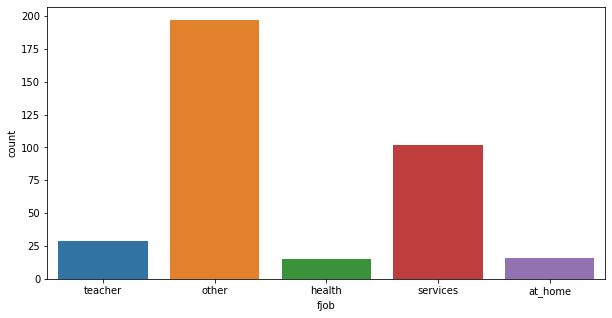

In [68]:
field_name='fjob'
check_field(field_name)

<span style="color:blue">36 незаполненных строчек... Интересно, что и тут большинство ответов у варианта other. 
Заполним строчки аналогично предыдущему полю.
</span>

In [69]:
# заполним самым часто встречающимся значением -"other"
stud_math_pdata[field_name] = stud_math_pdata[field_name].apply(lambda x: 'other' if pd.isna(x) or x=='nan' else x)

In [70]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 36
Осталось пропущенных значений: 0


count       395
unique        5
top       other
freq        233
Name: fjob, dtype: object


<AxesSubplot:xlabel='fjob', ylabel='count'>

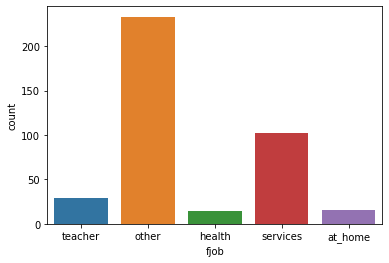

In [71]:
# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

<span style="color:blue">36 незаполненных строчек - заполнено значением "other". 
Аналогично полю "mjob" - чаще всего встречается ответ other.
</span>

In [72]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='36 незаполненных строчек - заполнено значением "other". \
Аналогично полю "mjob" - чаще всего встречается ответ other.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.11 reason** </font>

value_counts


,course,home,reputation,other
reason,137.0,104.0,103.0,34.0
%,34.7,26.3,26.1,8.6


,reason
description,"причина выбора школы ('home' - близость к дому, 'reputation' - репутация школы, 'course' - образовательная программа, 'other' - другое)"
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце reason встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


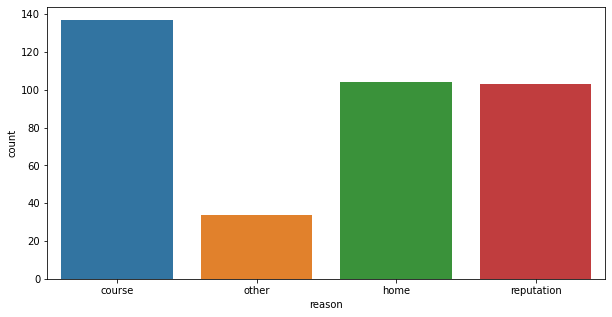

In [73]:
field_name='reason'
check_field(field_name)

<span style="color:blue">17 незаполненных строчек... Интересно, что большинство выбрали школу из-за программы обучения. Поскольку здесь мы не можем определить как лучше заполнить отсутствующие значения - заполним их значением "other"</span>

In [74]:
# заполним самым часто встречающимся значением -"other"
stud_math_pdata[field_name] = stud_math_pdata[field_name].apply(lambda x: 'other' if pd.isna(x) or x=='nan' else x)

count        395
unique         4
top       course
freq         137
Name: reason, dtype: object


<AxesSubplot:xlabel='reason', ylabel='count'>

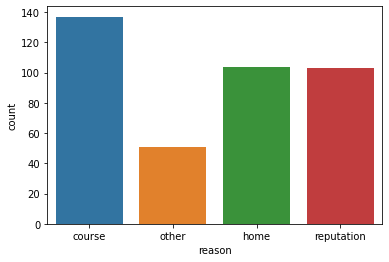

In [75]:
# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

In [76]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 17
Осталось пропущенных значений: 0


In [77]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='17 незаполненных строчек... Интересно, что большинство \
выбрали школу из-за программы обучения. Поскольку здесь мы не можем \
определить как лучше заполнить отсутствующие значения - заполним их \
значением "other"'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.12 guardian** </font>

value_counts


,mother,father,other
guardian,250.0,86.0,28.0
%,63.3,21.8,7.1


,guardian
description,"опекун ('mother' - мать, 'father' - отец, 'other' - другое)"
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце guardian встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


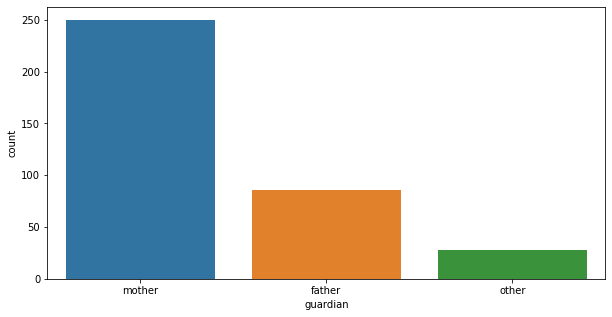

In [78]:
field_name='guardian'
check_field(field_name)

<span style="color:blue">31 незаполненная строчка - чаще всего опекуном является мать, поэтому заполним пропуски значением "mother"</span>

In [79]:
# заполним самым часто встречающимся значением -"mother"
stud_math_pdata[field_name] = stud_math_pdata[field_name].apply(lambda x: 'mother' if pd.isna(x) or x=='nan' else x)

count        395
unique         3
top       mother
freq         281
Name: guardian, dtype: object


<AxesSubplot:xlabel='guardian', ylabel='count'>

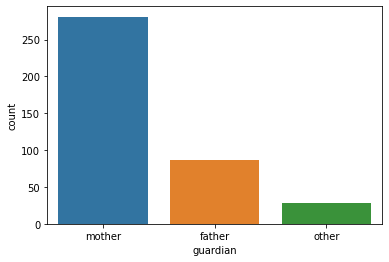

In [80]:
# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

In [81]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 31
Осталось пропущенных значений: 0


In [82]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='31 незаполненная строчка - чаще всего опекуном \
является мать, поэтому заполним пропуски значением "mother"'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.13 traveltime** </font>

value_counts


,1.0,2.0,3.0,4.0
traveltime,242.0,96.0,22.0,7.0
%,61.3,24.3,5.6,1.8


,traveltime
description,"время в пути до школы (1 - <15 мин., 2 - 15-30 мин., 3 - 30-60 мин., 4 - >60 мин.)"
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце traveltime встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


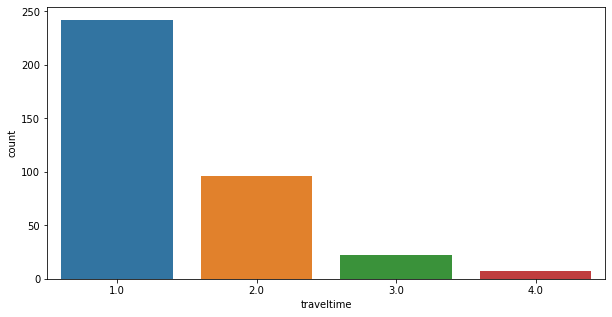

In [83]:
field_name='traveltime'
check_field(field_name)

У нас есть поле с названием школы в которой учится студент и местом проживания.  
Посмотрим есть ли зависимость времени в пути от школы и места проживания.

In [84]:
display(pd.DataFrame(stud_math_pdata.groupby(['address', 'school']).traveltime.mean()))

traveltime
address school            
R       GP        1.684211
        MS        2.200000
U       GP        1.309701
        MS        1.529412

Видно, что время в пути у городских студентов меньше чем у живущих за городом.   
По полю школа зависимость тоже есть, но она примерно такая же как и у места проживания - поэтому будем смотреть только на место проживания.  
Итого - поставим значение "1" для городских студентов и "2" для сельских. 

In [85]:
stud_math_pdata[field_name]= stud_math_pdata.apply(lambda x: (2 if x.address == 'R' else 1)\
                             if pd.isna(x[field_name]) or x[field_name]=='nan' else x[field_name] , axis=1)

In [86]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 28
Осталось пропущенных значений: 0


<span style="color:blue">по полученным данным видим, что выбросов и пропуски заполнены (хотя математика нам говорит, что выбросы есть - но это не так). Более 85% учеников живут в пешей доступности.</span>

In [87]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='по полученным данным видим, что выбросов и \
пропуски заполнены (хотя математика нам говорит, что выбросы \
есть - но это не так). Более 85% учеников живут в пешей \
доступности.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.14 studytime** </font>

value_counts


,2.0,1.0,3.0,4.0
studytime,194.0,103.0,64.0,27.0
%,49.1,26.1,16.2,6.8


,studytime
description,"время на учёбу помимо школы в неделю (1 - <2 часов, 2 - 2-5 часов, 3 - 5-10 часов, 4 - >10 часов)"
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце studytime встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


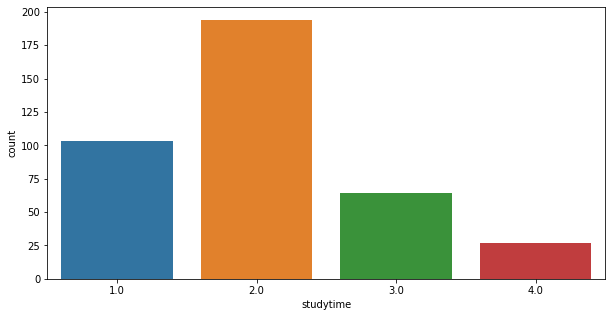

In [88]:
field_name='studytime'
check_field(field_name)

<AxesSubplot:xlabel='school', ylabel='count'>

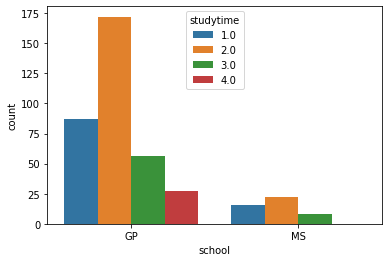

In [89]:
sns.countplot(x='school', data=stud_math_pdata, hue=field_name)

<AxesSubplot:xlabel='sex', ylabel='count'>

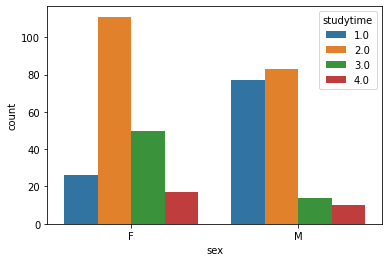

In [90]:
sns.countplot(x='sex', data=stud_math_pdata, hue=field_name)

<AxesSubplot:xlabel='school', ylabel='count'>

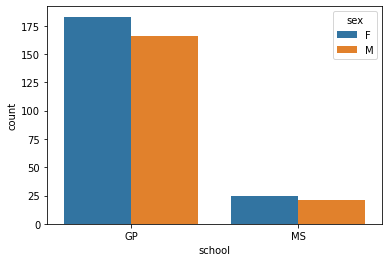

In [91]:
sns.countplot(x='school', data=stud_math_pdata, hue='sex')

In [92]:
df=pd.DataFrame(stud_math_pdata.groupby(['sex','school',field_name]).age.count())
df['%']=pd.DataFrame(round(stud_math_pdata.groupby(['sex','school',field_name]).size() / 
                           len(stud_math_pdata['sex'])*100,1))
display(df)

age     %
sex school studytime           
F   GP     1.0         22   5.6
           2.0         97  24.6
           3.0         43  10.9
           4.0         17   4.3
    MS     1.0          4   1.0
           2.0         14   3.5
           3.0          7   1.8
M   GP     1.0         65  16.5
           2.0         75  19.0
           3.0         13   3.3
           4.0         10   2.5
    MS     1.0         12   3.0
           2.0          8   2.0
           3.0          1   0.3

In [93]:
df=pd.DataFrame(stud_math_pdata.groupby(['sex','school'])[field_name].mean())
display(df)

studytime
sex school           
F   GP       2.307263
    MS       2.120000
M   GP       1.803681
    MS       1.476190

Явной зависимости найти не получилось, поэтому просто пропущенные значения заполним '2' (медианное значение).

In [94]:
stud_math_pdata[field_name]= stud_math_pdata.apply(
    lambda x: 2 if pd.isna(x[field_name]) or x[field_name]=='nan' else x[field_name], axis=1)

In [95]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 7
Осталось пропущенных значений: 0


<span style="color:blue">по полученным данным видим, что выбров и пропусков нет (заполнили '2'). Похоже, что здесь есть взаимосвязь с предыдущим столбцом traveltime, тк ученики меньше тратят времени на попадание домой и у них остаётся больше времени на учебу дома.</span>

In [96]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='по полученным данным видим, что выбров и \
пропусков нет (заполнили 2). Похоже, что \
здесь есть взаимосвязь с предыдущим столбцом traveltime, \
тк ученики меньше тратят времени на попадание домой и \
у них остаётся больше времени на учебу дома.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.15 failures** </font>

value_counts


,0.0,1.0,2.0,3.0
failures,293.0,49.0,16.0,15.0
%,74.2,12.4,4.1,3.8


,failures
description,"количество внеучебных неудач (n, если 1<=n<=3, иначе 0)"
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце failures встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


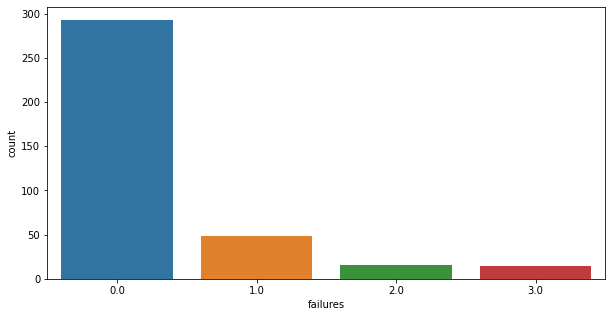

In [97]:
field_name='failures'
check_field(field_name)

Пропуски есть, и на этот раз мы заполним их средним значением. Поскольку среднее равно 0.33, а у нас принимаемые значения целые числа от 0 до 3 - то проставляем нулем.

In [98]:
stud_math_pdata[field_name]= stud_math_pdata.apply(
    lambda x: 0 if pd.isna(x[field_name]) or x[field_name]=='nan' else x[field_name], axis=1)

In [99]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 22
Осталось пропущенных значений: 0


<span style="color:blue">по полученным данным видим, что выбросов данных нет, 7 пропусков мы заполнили.  
(интересно, что функция по расчету выбросов отработала не корректно. скорее всего это из-за отсутствия разнообразия данных - у нас практически все значения равны нулю).  </span>
    
<span style="color:blue">Единственное, что здесь получается противоречивые данные - "0" означенает, что ошибок либо ноль, либо больше 3...  Это потенциально столбец на удаление из сэта, так он нас только запутывает, но решим это позднее.</span>

In [100]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='по полученным данным видим, что выбросов данных нет, \
7 пропусков мы заполнили. \
(интересно, что функция по расчету выбросов отработала не корректно. \
скорее всего это из-за отсутствия разнообразия данных - у нас \
практически все значения равны нулю). Единственное, что здесь \
получается противоречивые данные - "0" означенает, что ошибок \
либо ноль, либо больше 3...\
Это потенциально столбец на удаление из сэта, так он нас только \
запутывает, но решим это позднее.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.16 schoolsup** </font>

value_counts


,no,yes
schoolsup,335.0,51.0
%,84.8,12.9


,schoolsup
description,дополнительная образовательная поддержка (yes или no)
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце schoolsup встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


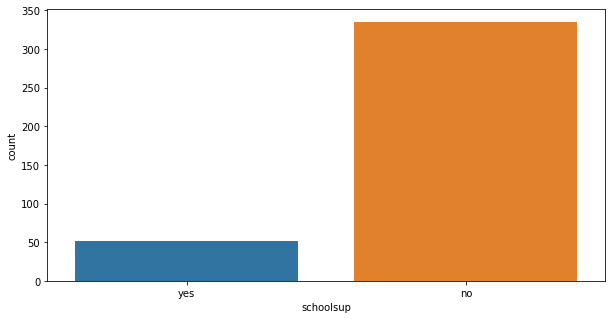

In [101]:
field_name='schoolsup'
check_field(field_name)

<span style="color:blue">84.8% не получают дополнительной образовательной поддержки, это либо все умные ребята, либо они не говорят правду. Поскольку самое часто встречающееся значение "no" - то заполним им пустые значения.</span>

In [102]:
# заполним самым часто встречающимся значением -"no"
stud_math_pdata[field_name] = stud_math_pdata[field_name].apply(lambda x: 'no' if x=='nan' or pd.isna(x) else x)

In [103]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 9
Осталось пропущенных значений: 0


count     395
unique      2
top        no
freq      344
Name: schoolsup, dtype: object


<AxesSubplot:xlabel='schoolsup', ylabel='count'>

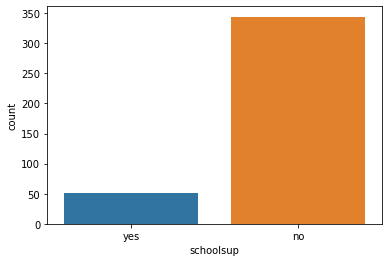

In [104]:
# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

In [105]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='84.8% не получают дополнительной образовательной \
поддержки, это либо все умные ребята, либо они не говорят правду.\
Поскольку самое часто встречающееся значение "no" - то заполнили \
им пустые значения.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.17 famsup** </font>

value_counts


,yes,no
famsup,219.0,137.0
%,55.4,34.7


,famsup
description,семейная образовательная поддержка (yes или no)
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце famsup встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


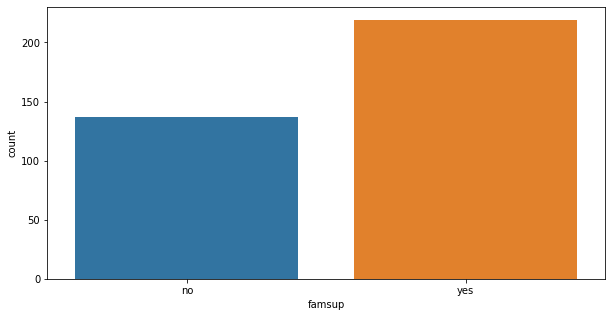

In [106]:
field_name='famsup'
check_field(field_name)

<span style="color:blue">55.4% получают семейную образовательную поддержку - интересно</span>

<AxesSubplot:xlabel='medu_fedu_mean', ylabel='count'>

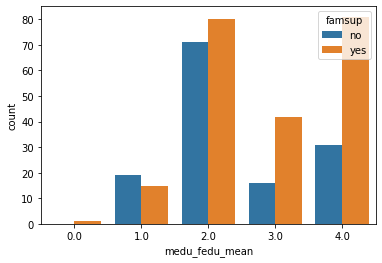

In [107]:
sns.countplot(x='medu_fedu_mean', data=stud_math_pdata, hue='famsup')

Видим, что родители помогают больше от среднего значения 2 - поставим "yes", для остальных "no"

count     395
unique      2
top         T
freq      346
Name: pstatus, dtype: object

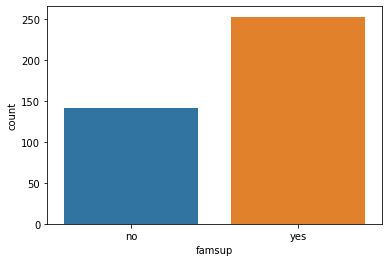

In [108]:
# заполняем пропущенные значения
stud_math_pdata[field_name] = stud_math_pdata.apply(lambda x: ('yes' if x.medu_fedu_mean >=2 else 'no')
                            if pd.isna(x[field_name]) or x[field_name]=='nan' else x[field_name] , axis=1)

# посмотрим на распределение
sns.countplot(x=field_name, data=stud_math_pdata)
stud_math_pdata.pstatus.describe()

In [109]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 39
Осталось пропущенных значений: 0


In [110]:
# посмотрим на распределение в числах
table_prc(field_name)

,famsup,%
yes,253,64.1
no,142,35.9


<span style="color:blue">Найдено и заполнено 39 пропусков в данных. 64% получают семейную образовательную поддержку - интересно...те в школе у них нет поддержки, а вот доме - есть.</span>

In [111]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='Найдено и заполнено 39 пропусков в данных. \
64% получают семейную образовательную поддержку - \
интересно...те в школе у них нет поддержки, а вот доме - есть.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.18 paid** </font>

value_counts


,no,yes
paid,200.0,155.0
%,50.6,39.2


,paid
description,дополнительные платные занятия по математике (yes или no)
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце paid встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


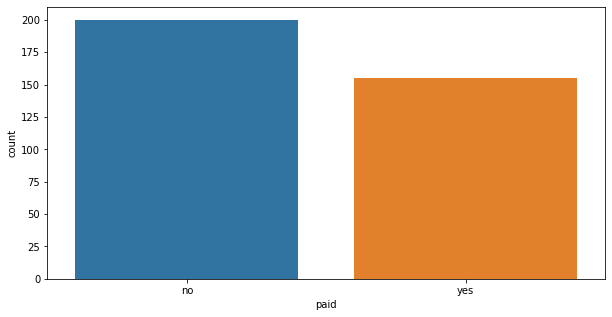

In [112]:
field_name='paid'
check_field(field_name)

<span style="color:blue">39.2% берут дополнительные платные занятия по математике...хотя в школе не берут дополнительных занятий, а дома получают гораздо больший процент. Пропусков очень много и чем их заполнить совсем не понятно, поэтому сделаем новую категорию "other".</span>

<AxesSubplot:xlabel='medu_fedu_mean', ylabel='count'>

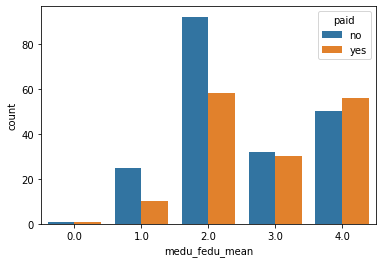

In [113]:
sns.countplot(x='medu_fedu_mean', data=stud_math_pdata, hue=field_name)

count     395
unique      2
top        no
freq      218
Name: paid, dtype: object


<AxesSubplot:xlabel='paid', ylabel='count'>

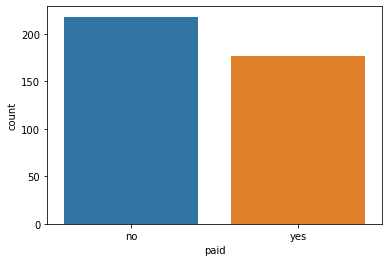

In [114]:
# заполним отсутствующие значения следующим образом, если medu_fedu_mean>=3 то проставим значение 'yes', иначе 'no'
stud_math_pdata[field_name] = stud_math_pdata.apply(lambda x: ('yes' if x.medu_fedu_mean >=3 else 'no')
                            if pd.isna(x[field_name]) or x[field_name]=='nan' else x[field_name] , axis=1)

# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

In [115]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 40
Осталось пропущенных значений: 0


<AxesSubplot:xlabel='paid', ylabel='score'>

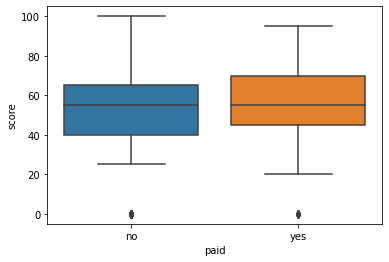

In [116]:
sns.boxplot(y = 'score', x = field_name, data=stud_math_pdata)

In [117]:
# посмотрим на распределение в числах
table_prc(field_name)

,paid,%
no,218,55.2
yes,177,44.8


In [118]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='45% берут дополнительные платные занятия \
по математике...хотя в школе не берут дополнительных занятий, \
а дома получают гораздо больший процент. Пропуски заполнили по \
соответствию с полем medu_fedu_mean.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.19 activities** </font>

value_counts


,yes,no
activities,195.0,186.0
%,49.4,47.1


,activities
description,дополнительные внеучебные занятия (yes или no)
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце activities встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


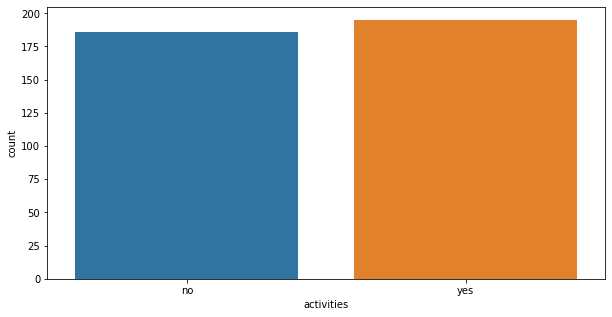

In [119]:
field_name='activities'
check_field(field_name)

<span style="color:blue">ученики поделились практически поровну по внеучебным занятиям, а вот это может объяснить почему платных занятий по математике берут меньше чем ожидалось - получается, что многие берут допзанятия по другим предметам. 
Поскольку распределение между посещающими и нет дополнительные внеучебные занятия практически одинаковое воспользуемся случайным генератором для заполнения пропусков в данных.</span>

count     395
unique      2
top       yes
freq      205
Name: activities, dtype: object


<AxesSubplot:xlabel='activities', ylabel='count'>

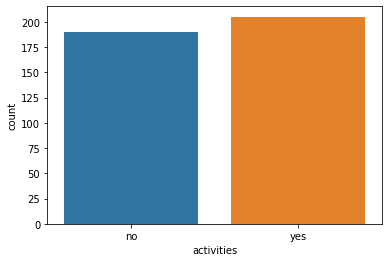

In [120]:
# заполним случайно выбранным значением
stud_math_pdata[field_name] = stud_math_pdata[field_name].apply(lambda x: \
                            (random.choice(['yes', 'no']) if x=='nan' or pd.isna(x) else x))

# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

In [121]:
# посмотрим на распределение в числах
table_prc(field_name)

,activities,%
yes,205,51.9
no,190,48.1


In [122]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 14
Осталось пропущенных значений: 0


In [123]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='ученики поделились практически поровну \
по внеучебным занятиям, а вот это может объяснить \
почему платных занятий по математике берут меньше \
чем ожидалось - получается, что многие берут допзанятия \
по другим предметам. Поскольку распределение между \
посещающими и нет дополнительные внеучебные занятия \
практически одинаковое воспользуемся случайным \
генератором для заполнения пропусков в данных.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.20 nursery** </font>

value_counts


,yes,no
nursery,300.0,79.0
%,75.9,20.0


,nursery
description,посещал детский сад (yes или no)
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце nursery встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


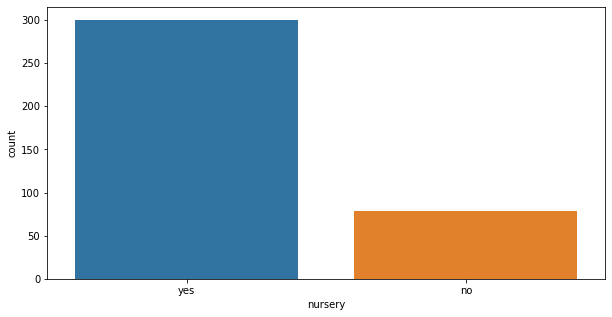

In [124]:
field_name='nursery'
check_field(field_name)

<span style="color:blue">75.9% ходили в садик - поэтому заполним отсутствующие значения "yes"</span>

count     395
unique      2
top       yes
freq      316
Name: nursery, dtype: object


<AxesSubplot:xlabel='nursery', ylabel='count'>

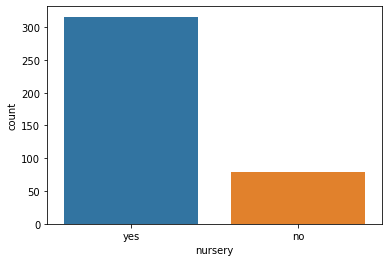

In [125]:
# заполним самым часто встречающимся значением -"yes"
stud_math_pdata[field_name] = stud_math_pdata[field_name].apply(lambda x: 'yes' if x=='nan' or pd.isna(x) else x)

# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

In [126]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 16
Осталось пропущенных значений: 0


In [127]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='Заполнено 16 пропущенных значений, \
при этом 75.9% ходили в садик - поэтому заполним \
отсутствующие значения "yes"'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.21 studytime_granular** </font>

In [128]:
field_name='studytime_granular'
check_field(field_name)

value_counts


,-6.0,-3.0,-9.0,-12.0
studytime_granular,194.0,103.0,64.0,27.0
%,49.1,26.1,16.2,6.8


<span style="color:red">Странное поле - его нету в описании к датасету.  
почему то отрицательные значения и по распределению учеников - половина в середине и еще четверть ниже середины.</span>

<AxesSubplot:xlabel='studytime', ylabel='studytime_granular'>

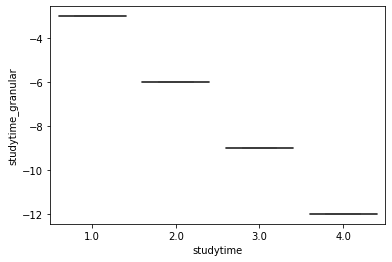

In [129]:
# У нас есть еще одно поле studytime по пробуем сравнить с ним.
sns.boxplot(y = 'studytime_granular', x = 'studytime', data=stud_math_pdata)

count    388.0
mean      -3.0
std        0.0
min       -3.0
25%       -3.0
50%       -3.0
75%       -3.0
max       -3.0
Name: studytime_granular_check, dtype: float64

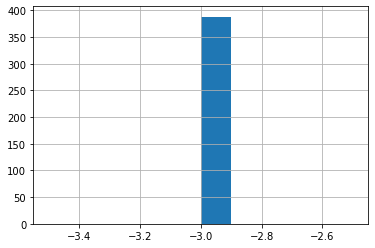

In [130]:
stud_math_pdata['studytime_granular_check'] = stud_math_pdata[field_name] / stud_math_pdata['studytime']

stud_math_pdata['studytime_granular_check'].hist()
# sns.distplot(stud_math_pdata['studytime_granular_check'])
stud_math_pdata['studytime_granular_check'].describe()


Вот как интересно, получается что признак studytime_granular получен путем умножения studytime на -3. Поэтому заполнение отсутствующих значений мы можем сделать умножив studytime на -3.

count    395.000000
mean      -6.113924
std        2.503740
min      -12.000000
25%       -6.000000
50%       -6.000000
75%       -3.000000
max       -3.000000
Name: studytime_granular, dtype: float64


<AxesSubplot:xlabel='studytime_granular', ylabel='count'>

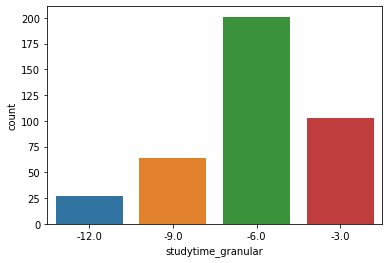

In [131]:
stud_math_pdata[field_name] = stud_math_pdata.apply(lambda x: (-3) * x.studytime\
                             if x.studytime_granular=='nan' or pd.isna(x.studytime_granular) else x.studytime_granular, axis=1)

# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

<AxesSubplot:xlabel='studytime_granular', ylabel='score'>

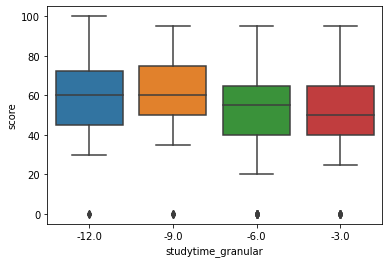

In [132]:
sns.boxplot(y = 'score', x =field_name, data=stud_math_pdata)

<AxesSubplot:xlabel='studytime', ylabel='score'>

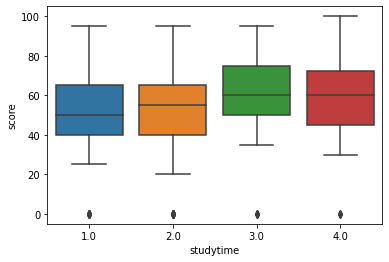

In [133]:
sns.boxplot(y = 'score', x = 'studytime', data=stud_math_pdata)

In [134]:
print(stud_math_pdata['studytime_granular_check'].describe())
# этот признак нам больше не нужен (мы нашли взаимосвязь 
# между двумя столбцами, и по факту он заполнен одной константой) - удаляем его.
del stud_math_pdata['studytime_granular_check']

count    388.0
mean      -3.0
std        0.0
min       -3.0
25%       -3.0
50%       -3.0
75%       -3.0
max       -3.0
Name: studytime_granular_check, dtype: float64


In [135]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='Странное поле - его нету в описании к датасету. \
почему то отрицательные значения и по распределению \
учеников - половина в середине и еще четверть ниже \
середины. Но мы нашли прямую взаимосвязь с столбцом \
studytime (через константу -3)'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.22 higher** </font>

value_counts


,yes,no
higher,356.0,19.0
%,90.1,4.8


,higher
description,хочет получить высшее образование (yes или no)
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце higher встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


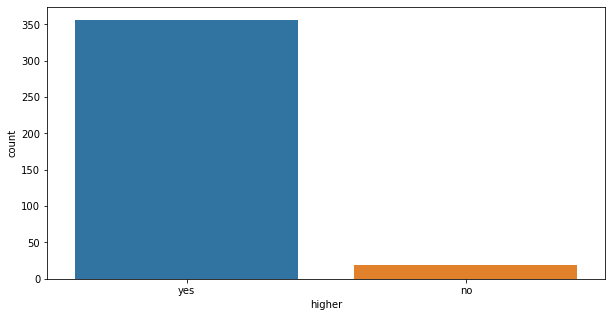

In [136]:
field_name='higher'
check_field(field_name)

<span style="color:blue">90.1% студентов хотят получить высшее образование.  
    Учитывая, что только 4.8% не хотят получить - мы можем заполнить отсутсвующие значение "yes".</span>

count     395
unique      2
top       yes
freq      376
Name: higher, dtype: object


<AxesSubplot:xlabel='higher', ylabel='count'>

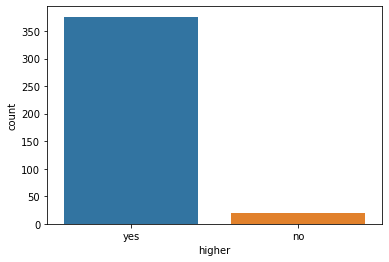

In [137]:
# заполним самым часто встречающимся значением -"yes"
stud_math_pdata[field_name] = stud_math_pdata[field_name].apply(lambda x: 'yes' if x=='nan' or pd.isna(x) else x)

# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

In [138]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 20
Осталось пропущенных значений: 0


In [139]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='90.1% студентов хотят получить высшее образование. \
Предварительный вывод по заполнению поля не совсем корректный...((( \
Учитывая, что только 4.8% не хотят получить - мы можем заполнить \
отсутсвующие значение "yes" - заполнили.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.23 internet** </font>

value_counts


,yes,no
internet,305.0,56.0
%,77.2,14.2


,internet
description,наличие интернета дома (yes или no)
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце internet встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


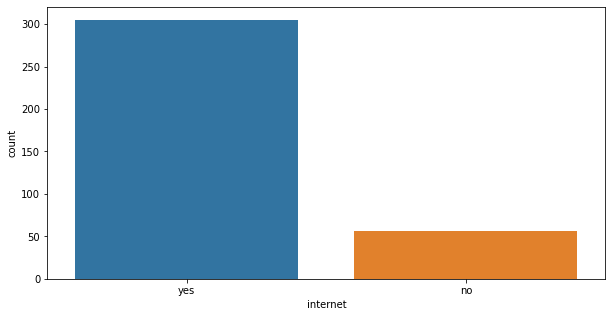

In [140]:
field_name='internet'
check_field(field_name)

<span style="color:blue">Разброс большой, но получается у 3/4 интернет точно есть. Будем считать и что в пропусках должен стоять ответ "yes"</span>

count     395
unique      2
top       yes
freq      339
Name: internet, dtype: object


<AxesSubplot:xlabel='internet', ylabel='count'>

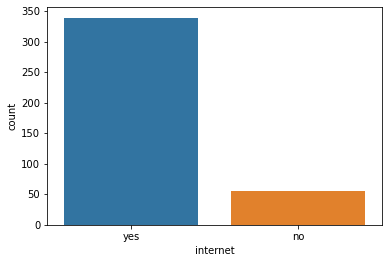

In [141]:
# заполним самым часто встречающимся значением -"yes"
stud_math_pdata[field_name] = stud_math_pdata[field_name].apply(lambda x: ('yes' if x=='nan' or pd.isna(x) else x))

# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

In [142]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 34
Осталось пропущенных значений: 0


In [143]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='Разброс большой, но получается у 3/4 интернет \
точно есть. Будем считать и что в пропусках должен стоять \
ответ "yes"'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.24 romantic** </font>

value_counts


,no,yes
romantic,240.0,124.0
%,60.8,31.4


,romantic
description,в романтических отношениях (yes или no)
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце romantic встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


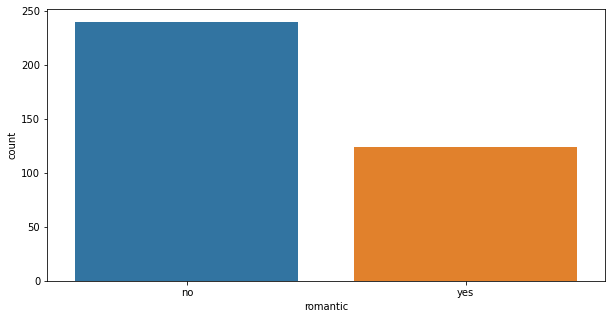

In [144]:
field_name='romantic'
check_field(field_name)

<span style="color:blue">Если уж и заполнить отсутсвующие значения - то "no". Проверим это далее.</span>

<AxesSubplot:xlabel='age', ylabel='count'>

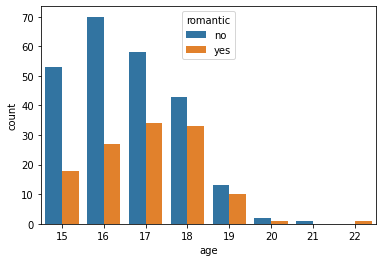

In [145]:
sns.countplot(x='age', data=stud_math_pdata, hue='romantic')

Чем младше ученики тем больше они не имеют романтических отношений

<AxesSubplot:xlabel='sex', ylabel='count'>

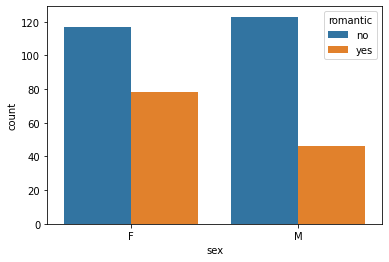

In [146]:
sns.countplot(x='sex', data=stud_math_pdata, hue='romantic')

А вот по полам ситуация другая, примерно одинаковое количество не состоят в отношениях, но вот девушеки чаще признаются что состоят в отношениях чем юноши. И тут же число пропусков по юношам больше чем у девушек. Может это случайность, а может юноши просто реже признаются и больше скрывают от остальных.

Сделаем заполнение исходя из возраста ученика. если возвраст меньше 18 - то ставим "no", иначе "yes". если возраст пропущен то ставим "no".

count     395
unique      2
top        no
freq      264
Name: romantic, dtype: object


<AxesSubplot:xlabel='romantic', ylabel='count'>

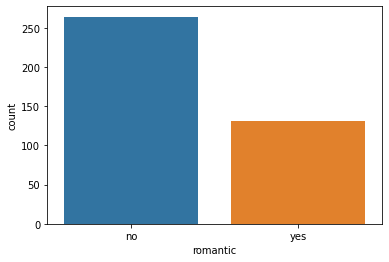

In [147]:
# поскольку мы уже заполнили поле age, то у нас упрощается формула на заполнение
stud_math_pdata[field_name] = stud_math_pdata.apply(lambda x: ('no' if x.age<18 else 'yes') 
                if pd.isna(x[field_name]) or x[field_name]=='nan' else x[field_name], axis=1)

# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

In [148]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 31
Осталось пропущенных значений: 0


In [149]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='31 пропуск сделаем заполнение \
исходя из возраста ученика. если возвраст \
меньше 18 - то ставим "no", иначе "yes"'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.25 famrel** </font>

value_counts


,4.0,5.0,3.0,2.0,1.0,-1.0
famrel,182.0,99.0,62.0,17.0,7.0,1.0
%,46.1,25.1,15.7,4.3,1.8,0.3


,famrel
description,семейные отношения (от 1 - очень плохо до 5 - очень хорошо)
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце famrel встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


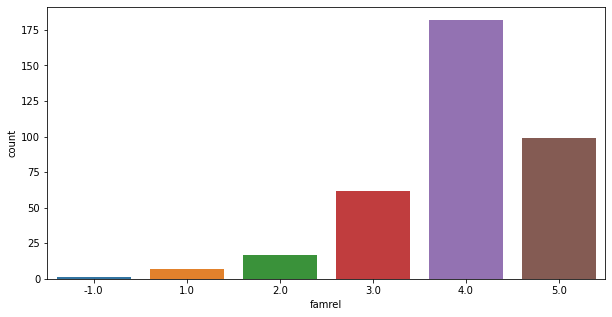

In [150]:
field_name='famrel'
check_field(field_name)

<span style="color:blue">Есть один выброс "-1". Очень похоже на опечатку. Исправим на "1". (математика снова пытается сказать, что у нас есть несколько выбросов, но это не так).</span>

In [151]:
# посмотрим сколько строчек со значением в нашем столбце меньше 0
print(stud_math_pdata[field_name].loc[stud_math_pdata[field_name] <0])

# найдем номер строки в которой у нас выброс
number_line=stud_math_pdata[stud_math_pdata.famrel==-1].index[0]

25   -1.0
Name: famrel, dtype: float64


In [152]:
# добавляем столбец с признаком изменения строки
write_changed_col(field_name,number_line)

# для проверки можем посчитать измененные столбцы и посмотреть таблицу с новом столбцом
display(stud_math_pdata.head(3))
display(stud_math_pdata.famrel_was_changed.value_counts())

,school,sex,age,address,famsize,pstatus,medu,fedu,mjob,fjob,reason,guardian,traveltime,studytime,failures,schoolsup,famsup,paid,activities,nursery,studytime_granular,higher,internet,romantic,famrel,...,romantic_was_missing,guardian_was_missing,traveltime_was_missing,famrel_was_missing,famsize_was_missing,fedu_was_missing,failures_was_missing,higher_was_missing,mjob_was_missing,address_was_missing,reason_was_missing,nursery_was_missing,health_was_missing,activities_was_missing,absences_was_missing,freetime_was_missing,schoolsup_was_missing,goout_was_missing,studytime_granular_was_missing,studytime_was_missing,score_was_missing,medu_was_missing,num_missing,medu_fedu_mean,famrel_was_changed
0,GP,F,18,U,LE3,A,4.0,4.0,at_home,teacher,course,mother,2.0,2.0,0.0,yes,no,no,no,yes,-6.0,yes,yes,no,4.0,...,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,2,4.0,False
1,GP,F,17,U,GT3,T,1.0,1.0,at_home,other,course,father,1.0,2.0,0.0,no,yes,no,no,no,-6.0,yes,yes,no,5.0,...,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,1,1.0,False
2,GP,F,15,U,LE3,T,1.0,1.0,at_home,other,other,mother,1.0,2.0,3.0,yes,no,no,no,yes,-6.0,yes,yes,no,4.0,...,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,2,1.0,False


False    394
True       1
Name: famrel_was_changed, dtype: int64

Теперь надо решить как заполнить путые строки

In [153]:
stud_math_famrel=stud_math_pdata.copy()
stud_math_famrel=stud_math_famrel[stud_math_famrel.famrel>=0]

# просто заменим на 1-ку
stud_math_fedu2=stud_math_pdata.copy()
stud_math_fedu2.loc[number_line,field_name]=1

# рассмотрим другие варианты замены

# замена на средне арифметическое
stud_math_fedu3=stud_math_pdata.copy()
stud_math_fedu3.loc[number_line,field_name]=stud_math_pdata.famrel.mean()

# замена на медианное
stud_math_fedu4=stud_math_pdata.copy()
stud_math_fedu4.loc[number_line,field_name]=stud_math_pdata.famrel.median()

# замена на моду
stud_math_fedu5=stud_math_pdata.copy()
stud_math_fedu5.loc[number_line,field_name]=stud_math_pdata.famrel.mode()[0]

# соберем все результаты в единую таблицу - для удобства сравнения вариантов
results_fedu=pd.DataFrame({
    'original':[stud_math_pdata[field_name].mean(),stud_math_pdata[field_name].median(),stud_math_pdata[field_name].mode()[0],
                stud_math_pdata[field_name].std(),stud_math_pdata[field_name].var()],
    'modyfied_del':[stud_math_famrel[field_name].mean(),stud_math_famrel[field_name].median(),
                    stud_math_famrel[field_name].mode()[0], stud_math_famrel[field_name].std(),
                    stud_math_famrel[field_name].var()],
    'modyfied_to_4':[stud_math_fedu2[field_name].mean(),stud_math_fedu2[field_name].median(),
                     stud_math_fedu2[field_name].mode()[0], stud_math_fedu2[field_name].std(),
                     stud_math_fedu2[field_name].var()],
    'modyfied_to_mean':[stud_math_fedu3[field_name].mean(),stud_math_fedu3[field_name].median(),
                        stud_math_fedu3[field_name].mode()[0], stud_math_fedu3[field_name].std(),
                        stud_math_fedu3[field_name].var()],
    'modyfied_to_median':[stud_math_fedu4[field_name].mean(),stud_math_fedu4[field_name].median(),
                          stud_math_fedu4[field_name].mode()[0],stud_math_fedu4[field_name].std(),
                          stud_math_fedu4[field_name].var()],
    'modyfied_to_mode':[stud_math_fedu5[field_name].mean(),stud_math_fedu5[field_name].median(),
                        stud_math_fedu5[field_name].mode()[0],stud_math_fedu5[field_name].std(),
                        stud_math_fedu5[field_name].var()],
},index = ['mean','median','mode','std','var'])
display(results_fedu)

,original,modyfied_del,modyfied_to_4,modyfied_to_mean,modyfied_to_median,modyfied_to_mode
mean,3.937500,3.950954,3.942935,3.950917,3.951087,3.951087
median,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000
mode,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000
std,0.927277,0.891853,0.903824,0.890638,0.890641,0.890641
var,0.859843,0.795402,0.816898,0.793235,0.793241,0.793241


<span style="color:red">сравнив полученные результаты - мне больше нравиться замена по медианному значению (по сравнению с удалением строки мы вообще не поменяем статистические показатели) - меняю в исходном сете значение выброса на него.</span>

In [154]:
# заменим значение выброса "-1" на 1
stud_math_pdata.loc[number_line,field_name]=1

count    395.000000
mean       3.946835
std        0.872425
min        1.000000
25%        4.000000
50%        4.000000
75%        4.500000
max        5.000000
Name: famrel, dtype: float64


<AxesSubplot:xlabel='famrel', ylabel='count'>

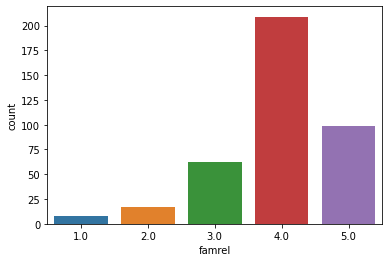

In [155]:
# теперь можем заполнить пропущенные значения на медианное
new_value=stud_math_pdata[field_name].median()
stud_math_pdata[field_name] = stud_math_pdata.apply(lambda x: new_value 
                if pd.isna(x[field_name]) or x[field_name]=='nan' else x[field_name], axis=1)

# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

In [156]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 27
Осталось пропущенных значений: 0


<span style="color:blue">так лучше - выброс заменен на 1,зафиксировали в отдельном столбце факт изменения значения и заполнили пустые значения</span>

In [157]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='так лучше - выброс заменен на 1,зафиксировали \
в отдельном столбце факт изменения значения и заполнили \
пустые значения.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.26 freetime** </font>

value_counts


,3.0,4.0,2.0,5.0,1.0
freetime,153.0,112.0,63.0,38.0,18.0
%,38.7,28.4,15.9,9.6,4.6


,freetime
description,свободное время после школы (от 1 - очень мало до 5 - очень мого)
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце freetime встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


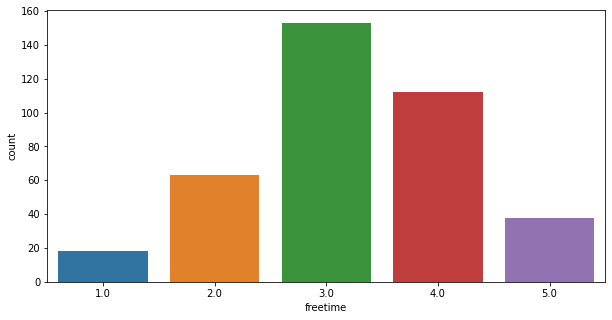

In [158]:
field_name='freetime'
check_field(field_name)

Заполним пропущенные значения на медианное значение ("3")

count    395.000000
mean       3.225316
std        0.980711
min        1.000000
25%        3.000000
50%        3.000000
75%        4.000000
max        5.000000
Name: freetime, dtype: float64


<AxesSubplot:xlabel='freetime', ylabel='count'>

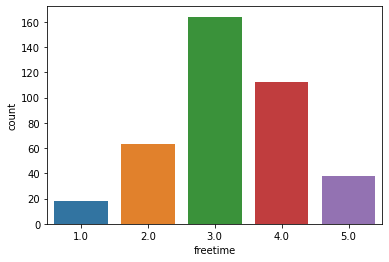

In [159]:
# теперь можем заполнить пропущенные значения на медианное
new_value=stud_math_pdata[field_name].median()
stud_math_pdata[field_name] = stud_math_pdata.apply(lambda x: new_value 
                if pd.isna(x[field_name]) or x[field_name]=='nan' else x[field_name], axis=1)

# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

In [160]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 11
Осталось пропущенных значений: 0


<span style="color:blue">Выбросов нету и пропуски заполнены. Здесь всё хорошо.  
По самим данным - ученики оценивают, что у них достаточно много свободного времени. (от 3 до 5 ответили - 76.8%)</span>

In [161]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='Выбросов нету и пропуски заполнены. \
Здесь всё хорошо. По самим данным - ученики \
оценивают, что у них достаточно много свободного \
времени. (от 3 до 5 ответили - 76.8%)'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.27 goout** </font>

value_counts


,3.0,2.0,4.0,5.0,1.0
goout,127.0,101.0,84.0,52.0,23.0
%,32.2,25.6,21.3,13.2,5.8


,goout
description,проведение времени с друзьями (от 1 - очень мало до 5 - очень много)
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце goout встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


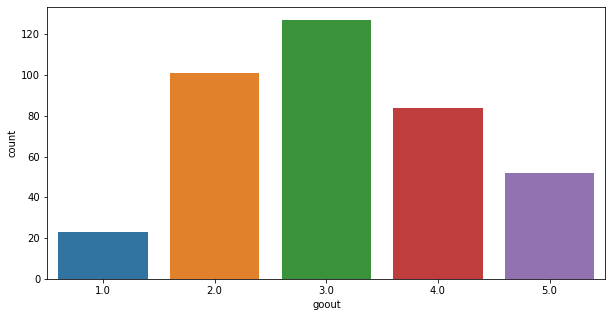

In [162]:
field_name='goout'
check_field(field_name)

count    395.000000
mean       3.103797
std        1.104610
min        1.000000
25%        2.000000
50%        3.000000
75%        4.000000
max        5.000000
Name: goout, dtype: float64


<AxesSubplot:xlabel='goout', ylabel='count'>

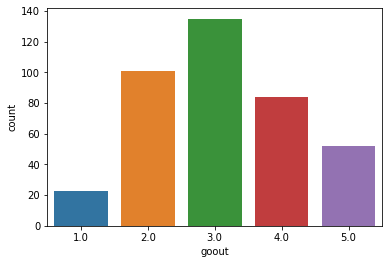

In [163]:
# теперь можем заполнить пропущенные значения на медианное
new_value=stud_math_pdata[field_name].median()
stud_math_pdata[field_name] = stud_math_pdata.apply(lambda x: new_value 
                if pd.isna(x[field_name]) or x[field_name]=='nan' else x[field_name], axis=1)

# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

In [164]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 8
Осталось пропущенных значений: 0


<span style="color:red">Выбросов нету. Пропуски заполнены.  
По самим данным - ученики оценивают, что они много выходят (от 3 до 5 ответили - 67.7%), но не так много как имеют свободного времени</span>

In [165]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='Выбросов нету. Пропуски заполнены. \
По самим данным - ученики оценивают, что они много выходят \
(от 3 до 5 ответили - 67.7%), но не так много как имеют свободного времени'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.28 health** </font>

value_counts


,5.0,3.0,4.0,1.0,2.0
health,138.0,89.0,63.0,47.0,43.0
%,34.9,22.5,15.9,11.9,10.9


,health
description,текущее состояние здоровья (от 1 - очень плохо до 5 - очень хорошо)
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце health встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


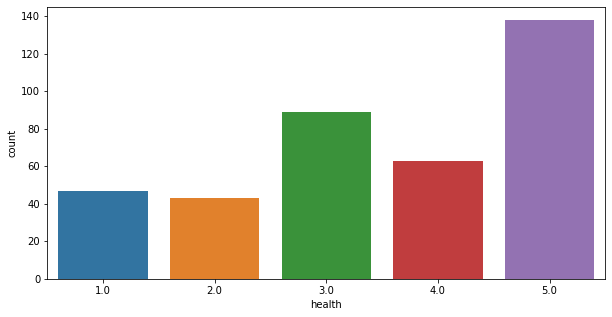

In [166]:
field_name='health'
check_field(field_name)

count    395.000000
mean       3.549367
std        1.372118
min        1.000000
25%        3.000000
50%        4.000000
75%        5.000000
max        5.000000
Name: health, dtype: float64


<AxesSubplot:xlabel='health', ylabel='count'>

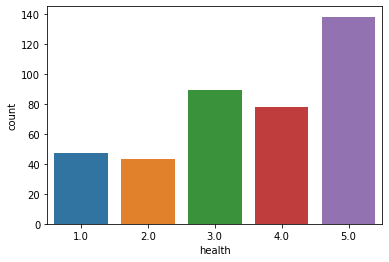

In [167]:
# заполняем пропущенные значения на медианное
new_value=stud_math_pdata[field_name].median()
stud_math_pdata[field_name] = stud_math_pdata.apply(lambda x: new_value 
                if pd.isna(x[field_name]) or x[field_name]=='nan' else x[field_name], axis=1)

# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

In [168]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 15
Осталось пропущенных значений: 0


<span style="color:blue">Выбросов нет. И учащиеся считают себя здоровыми - это хорошо!</span>

In [169]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='Выбросов нет. И учащиеся считают себя здоровыми - это хорошо!'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.29 absences** </font>

value_counts


,0.0,2.0,4.0,6.0,8.0,10.0,12.0,14.0,3.0,16.0,7.0,5.0,18.0,20.0,22.0,9.0,1.0,15.0,13.0,11.0,25.0,54.0,385.0,26.0,56.0,24.0,212.0,21.0,75.0,30.0,19.0,38.0,40.0,23.0,17.0,28.0
absences,111.0,60.0,53.0,31.0,21.0,17.0,12.0,12.0,8.0,7.0,6.0,5.0,5.0,4.0,3.0,3.0,3.0,2.0,2.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
%,28.1,15.2,13.4,7.8,5.3,4.3,3.0,3.0,2.0,1.8,1.5,1.3,1.3,1.0,0.8,0.8,0.8,0.5,0.5,0.5,0.3,0.3,0.3,0.3,0.3,0.3,0.3,0.3,0.3,0.3,0.3,0.3,0.3,0.3,0.3,0.3


,absences
description,количество пропущенных занятий
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце absences встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


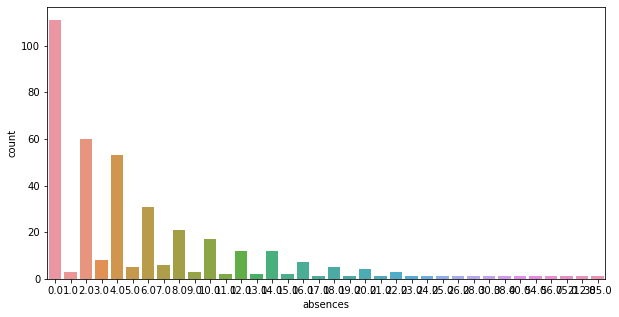

In [170]:
field_name='absences'
check_field(field_name)

<AxesSubplot:>

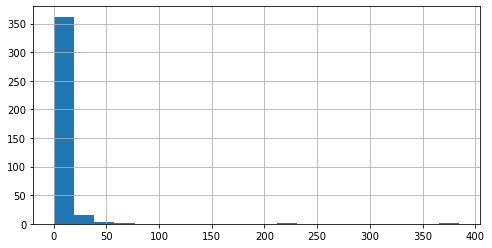

In [171]:
# поскольку разброс данных слишком большой - на графике ничего не понять - 
# построим гистограму с корзинками
plt.figure(figsize=(8,4))
stud_math_pdata.absences.hist(bins=20)

<span style="color:red">Из гистограммы видно, что большинство данных у нас лежит в диапазоне до 50, и хотя нам надо бы отсечь значения свыше 20 - я не буду трогать значения до 50, тк всегда есть исключения из правил и кто-то действительно мог болеть, или например, кто-то переехал по среди учебного процесса, а статистка показывает, что он пропустил занятия, хотя он и не жил даже в этом городе.  
Таким образом заменяем все значения выше 50 и отсутствующие на медианное значение.</span>

In [172]:
# получим индексы строчек со значением в нашем столбце больше 50
stud_math_absences=stud_math_pdata[field_name].loc[stud_math_pdata[field_name] >50]
print('строчек с выбросами: ',len(stud_math_absences))

# запишем индексы строчек с выбросами
list_of_lines=stud_math_absences.index

# пройдемся циклом и сохраним информацию по измененным строкам (чтобы потом видеть что именно мы меняли)
for line in stud_math_absences.index:
    # добавляем столбец с признаком изменения строки
    write_changed_col(field_name,line)

строчек с выбросами:  5


In [173]:
# для проверки можем посмотреть таблицу и значения в новом столбце
display(stud_math_pdata.head(3))
display(stud_math_pdata.absences_was_changed.value_counts())

,school,sex,age,address,famsize,pstatus,medu,fedu,mjob,fjob,reason,guardian,traveltime,studytime,failures,schoolsup,famsup,paid,activities,nursery,studytime_granular,higher,internet,romantic,famrel,...,guardian_was_missing,traveltime_was_missing,famrel_was_missing,famsize_was_missing,fedu_was_missing,failures_was_missing,higher_was_missing,mjob_was_missing,address_was_missing,reason_was_missing,nursery_was_missing,health_was_missing,activities_was_missing,absences_was_missing,freetime_was_missing,schoolsup_was_missing,goout_was_missing,studytime_granular_was_missing,studytime_was_missing,score_was_missing,medu_was_missing,num_missing,medu_fedu_mean,famrel_was_changed,absences_was_changed
0,GP,F,18,U,LE3,A,4.0,4.0,at_home,teacher,course,mother,2.0,2.0,0.0,yes,no,no,no,yes,-6.0,yes,yes,no,4.0,...,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,2,4.0,False,False
1,GP,F,17,U,GT3,T,1.0,1.0,at_home,other,course,father,1.0,2.0,0.0,no,yes,no,no,no,-6.0,yes,yes,no,5.0,...,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,1,1.0,False,False
2,GP,F,15,U,LE3,T,1.0,1.0,at_home,other,other,mother,1.0,2.0,3.0,yes,no,no,no,yes,-6.0,yes,yes,no,4.0,...,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,2,1.0,False,False


False    390
True       5
Name: absences_was_changed, dtype: int64

count    395.000000
mean       5.250633
std        6.204262
min        0.000000
25%        0.000000
50%        4.000000
75%        8.000000
max       40.000000
Name: absences, dtype: float64


<AxesSubplot:xlabel='absences', ylabel='count'>

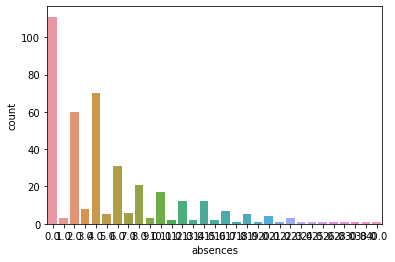

In [174]:
# произведем замену значений
new_value=stud_math_pdata[field_name].median()
stud_math_pdata[field_name] = stud_math_pdata.apply(lambda x: new_value if 
                 pd.isna(x[field_name]) or x[field_name]=='nan' or x[field_name]>50 else x[field_name], axis=1)

# посмотрим на результат
print(stud_math_pdata[field_name].describe())
sns.countplot(x=field_name, data=stud_math_pdata)

<span style="color:red">Пропусков в данных нет, выбросы поменяли на медианное значение.</span>

In [175]:
# проверим, что мы все заполнили
check_res_of_filling(field_name)

Было пропущенных значений: 12
Осталось пропущенных значений: 0


In [176]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='Пропуски и выбросы поменяли на медианное значение.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

## <font color='green'>**3.30 score** </font>

In [177]:
stud_math_pdata.describe()

,age,medu,fedu,traveltime,studytime,failures,studytime_granular,famrel,freetime,goout,health,absences,score,num_missing,medu_fedu_mean
count,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,395.000000,389.000000,395.00000,395.000000
mean,16.696203,2.751899,2.486076,1.425316,2.037975,0.318987,-6.113924,3.946835,3.225316,3.103797,3.549367,5.250633,52.262211,1.43038,2.678481
std,1.276043,1.094154,1.062362,0.680674,0.834580,0.726244,2.503740,0.872425,0.980711,1.104610,1.372118,6.204262,22.919022,1.20788,1.025273
min,15.000000,0.000000,0.000000,1.000000,1.000000,0.000000,-12.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.00000,0.000000
25%,16.000000,2.000000,2.000000,1.000000,1.000000,0.000000,-6.000000,4.000000,3.000000,2.000000,3.000000,0.000000,40.000000,1.00000,2.000000
50%,17.000000,3.000000,2.000000,1.000000,2.000000,0.000000,-6.000000,4.000000,3.000000,3.000000,4.000000,4.000000,55.000000,1.00000,2.000000
75%,18.000000,4.000000,3.000000,2.000000,2.000000,0.000000,-3.000000,4.500000,4.000000,4.000000,5.000000,8.000000,70.000000,2.00000,4.000000
max,22.000000,4.000000,4.000000,4.000000,4.000000,3.000000,-3.000000,5.000000,5.000000,5.000000,5.000000,40.000000,100.000000,6.00000,4.000000


value_counts


,50.0,55.0,0.0,75.0,65.0,40.0,60.0,70.0,45.0,80.0,30.0,90.0,35.0,25.0,85.0,95.0,100.0,20.0
score,54.0,46.0,37.0,33.0,31.0,31.0,31.0,27.0,27.0,16.0,15.0,12.0,9.0,7.0,6.0,5.0,1.0,1.0
%,13.7,11.6,9.4,8.4,7.8,7.8,7.8,6.8,6.8,4.1,3.8,3.0,2.3,1.8,1.5,1.3,0.3,0.3


,score
description,баллы по госэкзамену по математике
type_field,
fill_number,
not_fill_number,
num_uniq_values,
conlcusion,В столбце score встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения
conlcusion2,


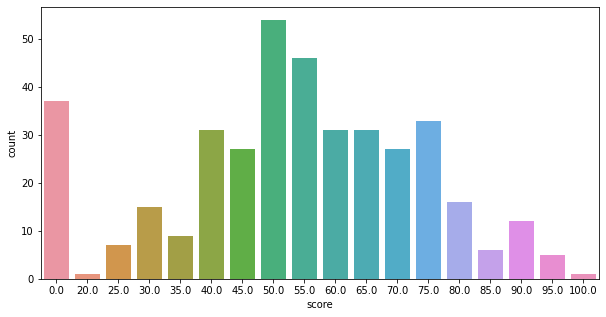

In [178]:
field_name='score'
check_field(field_name)

<span style="color:red">Выбросов нет. Судя по оценкам - шкала от 0 до 100 с шагом 5. Судя по распределению оценок - средняя оценка 52, и что удивительно очень много с оценкой 0 - 9.4% (37 учеников). И именно на них надо фокусировать исследование данных, надо найти чем они таким отличаются от остальных, чтобы понять чем им можно помочь.</span>

Поскольку пропущенных значений всего 6, то правильнее удалить строчки целиком, тк это наше ключевое поле и его изменение может повлиять на наше исследование. 

In [179]:
stud_math_pdata.head(3)
stud_math_pdata2=stud_math_pdata.copy()
stud_math_pdata2.dropna(subset=['score'], inplace=True)

In [180]:
# проверим наш набор данных по заполняемости
stud_math_pdata2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 389 entries, 0 to 394
Data columns (total 61 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   school                          389 non-null    object 
 1   sex                             389 non-null    object 
 2   age                             389 non-null    int64  
 3   address                         389 non-null    object 
 4   famsize                         389 non-null    object 
 5   pstatus                         389 non-null    object 
 6   medu                            389 non-null    float64
 7   fedu                            389 non-null    float64
 8   mjob                            389 non-null    object 
 9   fjob                            389 non-null    object 
 10  reason                          389 non-null    object 
 11  guardian                        389 non-null    object 
 12  traveltime                      389 

In [181]:
# добавим вывод по столбцу в таблицу с описанием
conlcusion2='Выбросов нет. Судя по оценкам - шкала от 0 до 100 с шагом 5. \
Судя по распределению оценок - средняя оценка 52, и что удивительно \
очень много с оценкой 0 - 9.4% (37 учеников). И именно на них надо \
фокусировать исследование данных, надо найти чем они таким отличаются \
от остальных, чтобы понять чем им можно помочь.'
stud_math_description['conlcusion2'].loc[field_name]=conlcusion2

<hr>

In [182]:
# посмотрим на все наши выводы 
display(stud_math_description)

,description,type_field,fill_number,not_fill_number,num_uniq_values,conlcusion,conlcusion2
column,,,,,,,
school,"аббревиатура школы, в которой учится ученик",,,,,В столбце school встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения,Категориальный признак. Пустых строчек нет - данные по этому столбцу полные и без выбросов. Всего два значения и более 88% принадлежит одному из них.
sex,"пол ученика ('F' - женский, 'M' - мужской)",,,,,В столбце sex встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения,"Категориальный признак не содержащий пропусков и имеющий только два уникальных значения, распределенных практичеки поровну. Данные по этому столбцу полные и без выбросов."
age,возраст ученика (от 15 до 22),,,,,В столбце age встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения,"по полученным данным видим, что у нас в основном учащиеся младшего возраста, практически все до 20 лет. Это хорошо - цель нашего исследования определить на ранней стадии проблемы с обучением. Такж..."
address,"тип адреса ученика ('U' - городской, 'R' - за городом)",,,,,В столбце address встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения,"Выбросов нет, но были пропуски - они заполнены релевантными данными. Из последнего графика видно, что ученики стараются идти в школу GP вне зависимости от места проживания. С чем это может быть св..."
famsize,"размер семьи('LE3' <= 3, 'GT3' >3)",,,,,В столбце famsize встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения,Около 72% учеников живут в большой семье (трое и более членов семьи). Пропуски заполнили.
pstatus,статус совместного жилья родителей ('T' - живут вместе 'A' - раздельно),,,,,В столбце pstatus встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения,Признак категориальный. 45 пропущенныех значений заполнено. 12.4% учеников живут в неполной семье.
medu,"образование матери (0 - нет, 1 - 4 класса, 2 - 5-9 классы, 3 - среднее специальное или 11 классов, 4 - высшее)",,,,,В столбце medu встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения,"По полученным данным видим, что выбросов нет. Более половины мам имеют среднее специальное или высшее образование"
fedu,"образование отца (0 - нет, 1 - 4 класса, 2 - 5-9 классы, 3 - среднее специальное или 11 классов, 4 - высшее)",,,,,В столбце fedu встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения,"Найденный выброс исправлен, отсутствующие значения заполнены. Для более простого анализа по семье введем новый признак - среднее образование матери и отца, которое будет показывать средний уровень..."
mjob,"работа матери ('teacher' - учитель, 'health' - сфера здравоохранения, 'services' - гос служба, 'at_home' - не работает, 'other' - другое)",,,,,В столбце mjob встречается уникальных значений. Число незаполненных строчек - . Надо бы заполнить отсутствующие значения,"Обнаружено 19 незаполненных строчек. Заполнили их значением ""other"""


## Преобразуем наши столбцы из float в int


In [183]:
list_of_col=['fedu','medu','traveltime','studytime',
             'failures','famrel','freetime','goout',
             'health','absences','score','age']

# поменяем тип на int
for col in list_of_col:
    stud_math_pdata[col]=stud_math_pdata[col].astype('Int64')

In [184]:
# Посмотрим итоговый набор данных на пропуски данных у признаков

# создадим список для заполнения данными
data=[]

# пройдемся циклом по всем столбцам и запишем результат в наш список
for col in stud_math_pdata2.columns:
    pct_missing = round(stud_math_pdata2[col].isna().mean()*100,2)
    nmb_missing = stud_math_pdata2[col].isna().sum()
    if pct_missing>0:
        data.append([col,pct_missing,nmb_missing])

# посмотрим на результат (col_name,pct_missing,nmb_missing - 
#        название столбца, процент и число пропусков соответственно)
results_missing=pd.DataFrame(data,columns=
        ['col_name','pct_missing','nmb_missing']).sort_values(by='pct_missing',ascending=False)
display(results_missing)
print('Столбцов с пропусками данных:',len(results_missing))  

,col_name,pct_missing,nmb_missing


Столбцов с пропусками данных: 0


<span style="color:red">Пропусков нет - можно продолжать</span>

# Посмотрим на наличие дублей строчек в нашем рабочем наборе данных

In [185]:
df1 = stud_math_pdata2[stud_math_pdata2.duplicated(keep=False)]
print('число дублирующихся строчек -',len(df1))

число дублирующихся строчек - 0


<span style="color:red">Получается, что у нас нету дублирующихся строчек можем работать дальше))</span>

# Корреляционный анализ числовых переменных

In [186]:
# вызовем функцию по составлению списка столбцов в зависимости от его типа 
# получим два списка object_cols (исключая bool), numeric_cols
cols=get_list_cols_by_types(stud_math_pdata2)[1:]
num_cols=[]
for item in cols:
    num_cols=item

# print(num_cols)

In [187]:
bool_list=['pstatus_was_missing','paid_was_missing','famsup_was_missing','fjob_was_missing','internet_was_missing',
'romantic_was_missing','guardian_was_missing','traveltime_was_missing','famrel_was_missing',
'famsize_was_missing','fedu_was_missing','failures_was_missing','higher_was_missing','mjob_was_missing','address_was_missing','reason_was_missing',
'nursery_was_missing','health_was_missing','activities_was_missing','absences_was_missing','freetime_was_missing','schoolsup_was_missing',
'goout_was_missing','studytime_granular_was_missing','studytime_was_missing','score_was_missing','medu_was_missing','famrel_was_changed','absences_was_changed']

obj_list=['school', 'sex', 'address', 'famsize', 'pstatus',
       'mjob', 'fjob', 'reason', 'guardian', 'traveltime',
       'schoolsup', 'famsup', 'paid', 'activities', 'nursery',
       'higher', 'internet', 'romantic', 'famrel', 'freetime', 'goout',
       'health']

In [188]:
data_num = stud_math_pdata2.drop(columns=obj_list)
data_num = data_num.drop(columns=bool_list)

# посмотрим на корреляцию между признаками
data_num.corr()

,age,medu,fedu,studytime,failures,studytime_granular,absences,score,num_missing,medu_fedu_mean
age,1.000000,-0.146405,-0.143849,-0.018019,0.206279,0.018019,0.188844,-0.155726,-0.036195,-0.177310
medu,-0.146405,1.000000,0.589360,0.079513,-0.239668,-0.079513,0.108322,0.209758,-0.013232,0.856898
fedu,-0.143849,0.589360,1.000000,0.011723,-0.260794,-0.011723,0.033990,0.124829,-0.076253,0.845192
studytime,-0.018019,0.079513,0.011723,1.000000,-0.169399,-1.000000,-0.079040,0.114295,-0.088563,0.048913
failures,0.206279,-0.239668,-0.260794,-0.169399,1.000000,0.169399,0.108300,-0.337187,0.039992,-0.289546
studytime_granular,0.018019,-0.079513,-0.011723,-1.000000,0.169399,1.000000,0.079040,-0.114295,0.088563,-0.048913
absences,0.188844,0.108322,0.033990,-0.079040,0.108300,0.079040,1.000000,0.054484,-0.013023,0.071784
score,-0.155726,0.209758,0.124829,0.114295,-0.337187,-0.114295,0.054484,1.000000,0.014992,0.178585
num_missing,-0.036195,-0.013232,-0.076253,-0.088563,0.039992,0.088563,-0.013023,0.014992,1.000000,-0.052861
medu_fedu_mean,-0.177310,0.856898,0.845192,0.048913,-0.289546,-0.048913,0.071784,0.178585,-0.052861,1.000000


<span style="color:red">Таблица не очень удобна для быстрого анализа - построим график</span>

<AxesSubplot:>

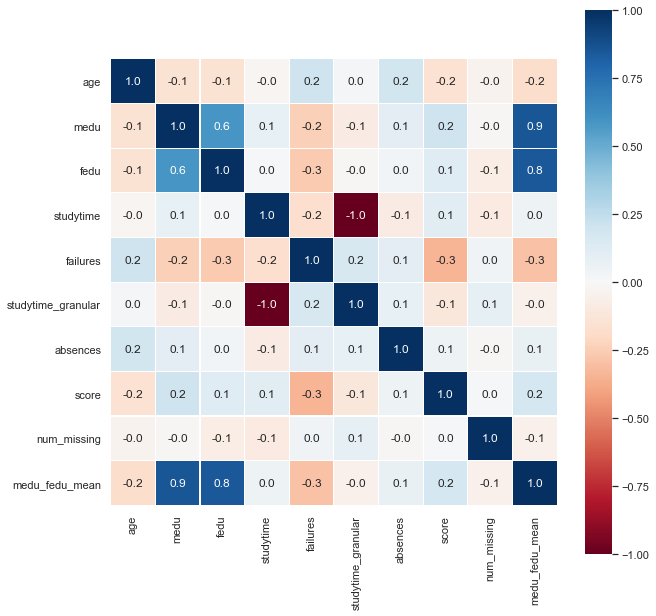

In [189]:
# построим тепловую карту по числовым столбцам
sns.set(font_scale = 1)
plt.subplots(figsize = (10,10))
sns.heatmap(data_num.corr(), square = True,
           annot = True, fmt = ".1f", linewidths = 0.1, cmap = 'RdBu')

как мы видим, анализ показа обратныю корреляцию между studytime и studytime_granular - поэтому мы можем удалить один из столбцов. И поскольку у нас нет описания для studytime_granular, то его мы и удалим.

In [190]:
stud_math_pdata2 = stud_math_pdata2.drop(columns='studytime_granular')

Очень интересно, что у нас есть зависимость между fedu и medu, те получается, что мужчины и женщины очень сильно смотрели на образоание будущего супруга - только так могла появиться такая зависимость. И есть две пары слабых зависимостий, между score и failuress - она обратная, те чем больше провалов тем меньше баллов. Вторая зависимость, между failures и fedu, она также обратная, тут как то не понятно, это можно трактовать как чем лучше образование у отца тем меньше провалов у ученика. Видимо, отцы как-то помогают или влияют на детей.

По результатам проведенного анализа, я бы оставил следующие числовые признаки: age, medu, fedu, studytime, failures и score.  
И я делал дополнительный признак - medu_fedu_mean, анализ показал, что он одинаково значим как и medu и fedu, поэтому считаю нужным оставить один этот столбец вместо двух исходных. Это позволит упростить наше моделирование, а значит сократить время расчетов (или можно будет, при получении новых данных увеличить набор данных для обучения модели и у нас это займет столько же времени).

Итого, оставляем 5 числовых переменных: age, medu_fedu_mean, studytime, failures и score.

## Корреляционный анализ номинативных переменных

Проведем анализ с помощью теста Стьюдента.

In [191]:
stud=stud_math_pdata2.copy()
            
def get_corr_cols(column):
    # Находим все уникальные значения признака
    cols = stud.loc[:, column].value_counts().index[:10]
    
    # Составляем все комбинации из списка уникальных значений
    combinations_all = list(combinations(cols, 2))

    # Применяем t-тест для всех полученных комбинаций и пытаемся
    # найти статистическую разницу в распределении целевой переменной score.
    for comb in combinations_all:
        if ttest_ind(stud.loc[stud.loc[:, column] == comb[0], 'score'], 
                        stud.loc[stud.loc[:, column] == comb[1], 'score']).pvalue \
            <= 0.05/len(combinations_all): # Учли поправку Бонферони
            print('Найдены статистически значимые различия для признака', column)
            break

In [192]:
for col in obj_list:
    get_corr_cols(col)

Найдены статистически значимые различия для признака mjob
Найдены статистически значимые различия для признака higher
Найдены статистически значимые различия для признака romantic


Получилось, что у нас влияют три поля на итоговый результат экзамена по математике mjob,higher и romantic.
Из цифровых полей у нас значимыми получились age, medu_fedu_mean, studytime, failures и score.

Соответственно оставим все эти поля для финального сета данных.

In [193]:
final_list_fields=['age','medu_fedu_mean','studytime','failures',
                   'score','mjob','higher','romantic']

final_set = pd.DataFrame()
final_set= stud_math_pdata2.loc[:,stud_math_pdata2.columns.isin(final_list_fields)]

final_set.sample(5)

,age,mjob,studytime,failures,higher,romantic,score,medu_fedu_mean
298,18,other,4.0,0.0,yes,no,70.0,4.0
391,17,services,1.0,0.0,yes,no,80.0,2.0
362,18,services,2.0,0.0,yes,yes,50.0,3.0
344,18,at_home,3.0,0.0,yes,no,50.0,2.0
339,17,other,2.0,0.0,yes,no,50.0,2.0


In [194]:
# также у нас есть сохраненные данные по пропускам и измененным выбросам
# названия столбцов заканчиваются на "_was_missing" и "_was_changed"
stud_math_pdata2.sample(3)

,school,sex,age,address,famsize,pstatus,medu,fedu,mjob,fjob,reason,guardian,traveltime,studytime,failures,schoolsup,famsup,paid,activities,nursery,higher,internet,romantic,famrel,freetime,...,guardian_was_missing,traveltime_was_missing,famrel_was_missing,famsize_was_missing,fedu_was_missing,failures_was_missing,higher_was_missing,mjob_was_missing,address_was_missing,reason_was_missing,nursery_was_missing,health_was_missing,activities_was_missing,absences_was_missing,freetime_was_missing,schoolsup_was_missing,goout_was_missing,studytime_granular_was_missing,studytime_was_missing,score_was_missing,medu_was_missing,num_missing,medu_fedu_mean,famrel_was_changed,absences_was_changed
354,MS,M,17,R,GT3,T,4.0,3.0,services,other,home,mother,2.0,2.0,0.0,no,yes,yes,yes,no,yes,yes,yes,4.0,5.0,...,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,1,4.0,False,False
291,GP,F,17,U,GT3,T,4.0,3.0,other,services,reputation,mother,1.0,3.0,0.0,no,yes,yes,no,yes,yes,yes,no,4.0,3.0,...,True,False,False,False,False,False,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,3,4.0,False,False
164,GP,M,17,R,LE3,T,1.0,1.0,other,services,course,mother,4.0,2.0,3.0,no,no,no,yes,yes,no,no,yes,5.0,3.0,...,True,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,3,1.0,False,False


Модель работает только с числовыми данными поэтому нам надо заменить все текстовые значения на цифровые.  
Воспользуюсь функцией get_dummies()

In [195]:
for col in ['mjob','higher','romantic']:
    final_set = final_set.join(pd.get_dummies(final_set[col], prefix=col))
    final_set = final_set.drop(columns=[col])
    
# посмотрим на результат
display(final_set.sample(3))
final_set.info()

,age,studytime,failures,score,medu_fedu_mean,mjob_at_home,mjob_health,mjob_other,mjob_services,mjob_teacher,higher_no,higher_yes,romantic_no,romantic_yes
320,17,2.0,0.0,65.0,4.0,0,0,0,1,0,0,1,0,1
110,15,1.0,0.0,95.0,4.0,0,0,0,0,1,0,1,1,0
49,15,2.0,1.0,35.0,4.0,0,0,0,1,0,0,1,1,0


<class 'pandas.core.frame.DataFrame'>
Int64Index: 389 entries, 0 to 394
Data columns (total 14 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             389 non-null    int64  
 1   studytime       389 non-null    float64
 2   failures        389 non-null    float64
 3   score           389 non-null    float64
 4   medu_fedu_mean  389 non-null    float64
 5   mjob_at_home    389 non-null    uint8  
 6   mjob_health     389 non-null    uint8  
 7   mjob_other      389 non-null    uint8  
 8   mjob_services   389 non-null    uint8  
 9   mjob_teacher    389 non-null    uint8  
 10  higher_no       389 non-null    uint8  
 11  higher_yes      389 non-null    uint8  
 12  romantic_no     389 non-null    uint8  
 13  romantic_yes    389 non-null    uint8  
dtypes: float64(4), int64(1), uint8(9)
memory usage: 31.7 KB


Выводы о данных.  

1. Практически во всех столбцах отсутствуют данные (в 27 из 30), в паре из них (pstatus, paid) отсутствует более 10% строчек.
2. По заполненности строчек - 97 строк не содержат пропусков, а около 130 строк содержат только 1 пропуск в данных. Эти строки можно найти в stud_math_pdata2 по столбцу num_missing. (Все остальные строки содержат от 2 и до 6 пропусков).  
3. Все пропуски были заполнены (кроме ключевого столбца score - там я строки удалил).  
4. Выбросов практически не было, часть я исправил на медианные, а часть исправил изходя из принципа разумности.  
5. По результатам корреляционного анализа цифровых полей заметил следующее. Есть зависимость между fedu и medu, те получается, что мужчины и женщины очень сильно смотрели на образование будущего супруга - только так могла появиться такая зависимость. И есть две пары слабых зависимостий, между score и failuress - она обратная, те чем больше провалов тем меньше баллов. Вторая зависимость, между failures и fedu, она также обратная, тут как то не понятно, это можно трактовать как чем лучше образование у отца тем меньше провалов у ученика. Видимо, отцы как-то помогают или влияют на детей.
6. По результатам корреляционного анализа номинативных переменных найдены статистически значимые различия для 3х колонок. Наиболее значимую зависимость показал признак mjob, другие же два не так сильно влияют.
7. В финальном наборе данных осталось:
    * 4 числовых признака (age, medu_fedu_mean, studytime, failures)
    * и 3 номинантивных признака (mjob, higher, romantic)
8. Все текcтовые признаки были переведены в цифровым через функцию get_dummies()
9. Я сохранил данные по всем отсутствующим или замененным признакам, на случай необходимости корректировки/отчистки финальных данных.
10. Финальный набор данных сохранен в отдельный файл (final_set.csv)



In [197]:
# сохраним финальный сет в файл
final_set.to_csv('final_set.csv')

# также сохраним таблицу-описание
stud_math_description.to_csv('final_set_description.csv')

# и сохраним еще фрейм с обработанными, но не удаленными столбцами (это к п.9 выводов)
stud_math_pdata2.to_csv('pre_final_set.csv')